<a href="https://colab.research.google.com/github/rnshalinda/Veg_detect_ML_model/blob/main/Best_Model_Yolov5n6_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font color='white'>**A Reliable Approach to Vegitable Detection in Agriculture with** <font color='cyan'>**YOLO**<font color='white'>**v5**</font>

    LJMU ID : 978727
    ICBT ID : CL/BENG/MASE/10/12
    Name    : H R Nirmala S
    e-mail  : nsrhewa@gmail.com
    Module  : 6613ELEICB

###⭐ **Dataset Used** :
## **Food Dataset Computer Vision Project**
`Dataset --v6  2024-03-28 8:52pm [update]`

### By Roboflow 🍉 [goto-dataset](https://universe.roboflow.com/final-year-project-zjplh/food-dataset-e5zas)


---


### **LICENSE** : **CC BY 4.0** ▶  [Link](https://creativecommons.org/licenses/by/4.0/)


---

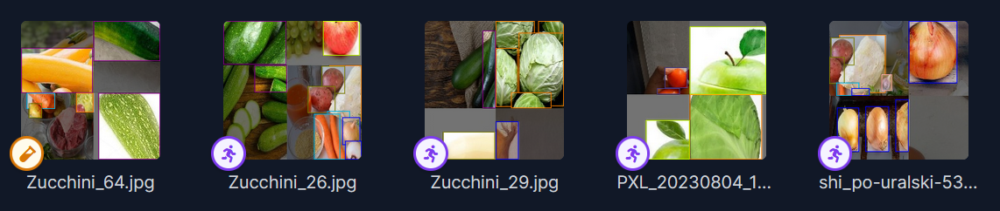

## **Data is preprocessed into** ✅

Preprocessing    

                - Auto-Orient: Applied
                - Resize: Stretch to 640 ✖ 640
        

Augmentations     

                - Outputs per training example: 3
                - Flip: Horizontal
                  

### Dataset contains 12558 images anotated and devided into,

         -- Train -- Vatidate -- Test --

### Dataset structure :

```
        -- Food-Dataset-6
              |
              |--Test
              |    |-- image
              |    |-- label
              |--Valid
              |    |-- image
              |    |-- label
              |--Test
              |    |-- image
              |    |-- label
              |--data.ymal
        
```

### 🗒 <font color='orange'>**Classes :**<font color='white'> **15**</font></font>
```
              -|----------------|---------------|----------------|-
               | 0. Apple	   | 5. Cabbage    | 10. Onion      |
               | 1. Banana      | 6. Carrot     | 11. Orange     |
               | 2. Beetroot    | 7. Cucumber   | 12. Potato     |
               | 3. Bell pepper | 8. Egg        | 13. Tomato     |
               | 4. Brinjal     | 9. Garlic     | 14. Zucchini   |
              -|----------------|---------------|----------------|-

```

## Dataset Citation :
```
@misc{
       food-dataset-e5zas_dataset,
       title = { Food Dataset Dataset },
       type = { Open Source Dataset },
       author = { Final Year Project },
       howpublished = { \url{ https://universe.roboflow.com/final-year-project-zjplh/food-dataset-e5zas } },
       url = { https://universe.roboflow.com/final-year-project-zjplh/food-dataset-e5zas },
       journal = { Roboflow Universe },
       publisher = { Roboflow },
       year = { 2024 },
       month = { mar },
       note = { visited on 2024-04-17 },
      }
```

## 📚  **Import Dataset**

Following code downloads and unzips dataset from Roboflow.


---


**Check root directory '/content/Food-Dataset-6 --> Train | Validate | Test '**

In [1]:
# If Restart session warning appeared, May have to run it twice
%cd /content/
!pip install roboflow

/content
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 15.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.5 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.7
    Uninstalling idna-3.7:
      Successfully uninstalled idna-3.7
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uninstalled 

In [1]:
%cd /content/
# Download and extract dataset
from roboflow import Roboflow
rf = Roboflow(api_key="sPw6PtxKukIIJmhCkYXf")
project = rf.workspace("final-year-project-zjplh").project("food-dataset-e5zas")
version = project.version(6)
dataset = version.download("yolov5")

/content
loading Roboflow workspace...
loading Roboflow project...


## ⛳ **Explore dataset**

### Actual image split count and dementions

In [ ]:
import os
from PIL import Image
import glob as glob


train_dir = "/content/Food-Dataset-6/train/images"
test_dir = "/content/Food-Dataset-6/test/images"
val_dir = "/content/Food-Dataset-6/valid/images"

train_images, test_images, val_images = [], [], []

for directory in [train_dir, test_dir, val_dir]:
  for filename in os.listdir(directory):
    image_path = os.path.join(directory, filename)
    image = Image.open(image_path)
    if directory == train_dir:
      train_images.append(image)
    elif directory == test_dir:
      test_images.append(image)
    else:
      val_images.append(image)

# Get image dimensions
train_dims = [(image.width, image.height) for image in train_images]
test_dims = [(image.width, image.height) for image in test_images]
val_dims = [(image.width, image.height) for image in val_images]

# Print shapes and dimensions
print("Dataset contains,")
print(f"      Train images : {len(train_images)}  |  Dimensions: {train_dims[0]}")
print(f"      Test images  : {len(test_images)}  |  Dimensions: {test_dims[0]}")
print(f"      valid images : {len(val_images)}  |  Dimensions: {val_dims[0]}")

total_images = len(train_images) + len(test_images) + len(val_images)
print(f"\n      Total images : {total_images}")


Dataset contains,
      Train images : 9917  |  Dimensions: (640, 640)
      Test images  : 1202  |  Dimensions: (640, 640)
      valid images : 1392  |  Dimensions: (640, 640)

      Total images : 12511


### Number of classes, Number of data entries for each classes

In [ ]:
import os
import yaml
from collections import defaultdict

# Path to the data.yaml file
data_yaml_path = '/content/Food-Dataset-6/data.yaml'

# Load the data.yaml file
with open(data_yaml_path, 'r') as file:
    data = yaml.safe_load(file)

# Get the list of classes
classes = data['names']

# Initialize a dictionary to store the count of data entries for each class
class_counts = defaultdict(int)

# Define the label folders
label_folders = ['test/labels', 'train/labels', 'valid/labels']

# Traverse through the label folders
for label_folder in label_folders:
    label_folder_path = os.path.join('/content/Food-Dataset-6', label_folder)

    # Iterate through each label file in the label folder
    for file_name in os.listdir(label_folder_path):
        file_path = os.path.join(label_folder_path, file_name)

        # Open and read the label file
        with open(file_path, 'r') as label_file:
            lines = label_file.readlines()

            # Extract class indices from the label file and update class counts
            for line in lines:
                class_index = int(line.split()[0])
                class_name = classes[class_index]
                class_counts[class_name] += 1

# Filter out classes with zero data entries
class_counts = {class_name: count for class_name, count in class_counts.items() if count > 0}

# Sort classes based on the number of data entries
sorted_class_counts = sorted(class_counts.items(), key=lambda x: x[1], reverse=True)

# Print the summary
print("Summary:")
print(f"Total Number of Classes: {len(classes)}\n")
print(f"{'Class':<33}{'Number of Data Entries':<20}\n")
for class_name, count in sorted_class_counts:
    print(f"{class_name:<37}{count:<20}")


Summary:
Total Number of Classes: 15

Class                            Number of Data Entries

cucumber                             7195                
carrot                               6600                
onion                                6596                
tomato                               5964                
beetroot                             4933                
brinjal                              4758                
bell pepper                          4712                
potato                               4226                
banana                               4207                
zucchini                             3824                
apple                                3604                
orange                               3594                
egg                                  3512                
garlic                               3511                
cabbage                              3167                


### Display few train samples

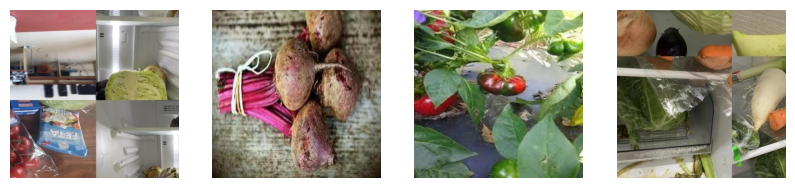

In [ ]:
import matplotlib.pyplot as plt
cnt = 4  # images count
# Display images
plt.figure(figsize=(10, 10))
for i in range(cnt):
    plt.subplot(1, cnt, i + 1)
    plt.imshow(train_images[i])
    plt.axis('off')
plt.show()

### Sample annotations with bounding box coordinates

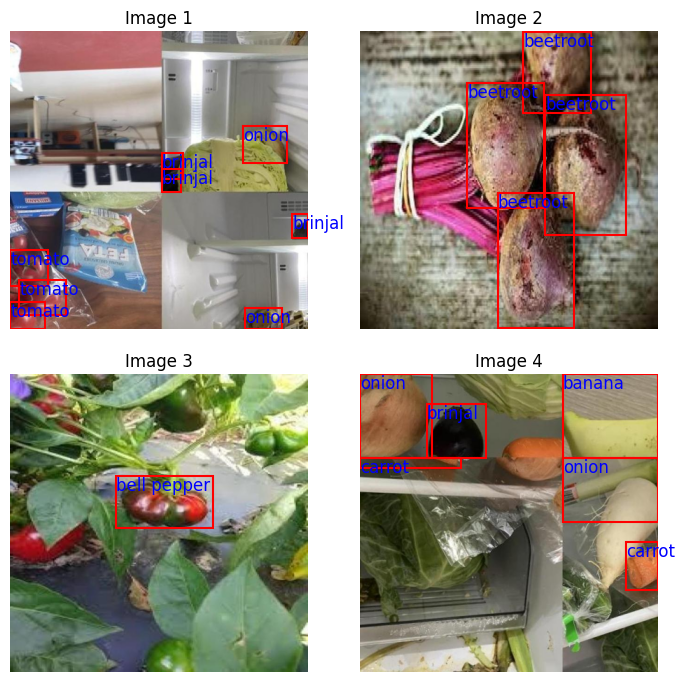

In [ ]:
import cv2

count = 4  # Number of images to dispaly
figz = 7  # figure size

# Train paths
train_img_dir = "/content/Food-Dataset-6/train/images"
train_labels_dir = "/content/Food-Dataset-6/train/labels"

# Classes
classes = ["apple", "banana", "beetroot", "bell pepper", "brinjal", "cabbage", "carrot", "cucumber", "egg", "garlic", "onion", "orange", "potato", "tomato", "zucchini"]

# Function to parse bounding box labels
def parse_labels(label_file_path, image_shape):
    with open(label_file_path, 'r') as file:
        lines = file.readlines()
        boxes = []
        for line in lines:
            class_index, x_center, y_center, width, height = map(float, line.split())

            # Convert normalized coordinates to absolute coordinates
            img_height, img_width, _ = image_shape
            x_min = int((x_center - width / 2) * img_width)
            y_min = int((y_center - height / 2) * img_height)
            x_max = int((x_center + width / 2) * img_width)
            y_max = int((y_center + height / 2) * img_height)

            boxes.append((classes[int(class_index)], x_min, y_min, x_max, y_max))
        return boxes

# Function to display images with bounding boxes
def display_images_with_boxes(image_dir, label_dir, num_images=None):
    fig, axes = plt.subplots((num_images + 1) // 2, 2, figsize=(figz, figz))
    axes = axes.flatten()
    image_files = os.listdir(image_dir)
    if num_images:
        image_files = image_files[:num_images]
    for i, file_name in enumerate(image_files):
        img_path = os.path.join(image_dir, file_name)
        label_path = os.path.join(label_dir, os.path.splitext(file_name)[0] + ".txt")

        # Read image
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Parse labels
        image = cv2.imread(img_path)
        boxes = parse_labels(label_path, image.shape)

        # Display image
        axes[i].imshow(img)
        axes[i].set_title(f"Image {i+1}")

        # Plot bounding boxes
        for box in boxes:
            class_name, x_min, y_min, x_max, y_max = box
            rect = plt.Rectangle((x_min, y_min), x_max-x_min, y_max-y_min, linewidth=1.5, edgecolor='r', facecolor='none')
            axes[i].add_patch(rect)
            axes[i].text(x_min, y_min, class_name, fontsize=12, color='blue', verticalalignment='top')

        axes[i].axis('off')
    plt.tight_layout()
    plt.show()

# Display images with bounding boxes
display_images_with_boxes(train_img_dir, train_labels_dir, num_images=count)


# 🔶 **<font color="white">Important</font> <font color="#FFD700">Notice :</font>**

- <font size="+1">If you have cloned my Github repo [ **Veg_dtect** ] to your Google Colab notebook, by running : </font>
        !git clone https://github.com/rnshalinda/Veg_detect_ML_model.git
- <font size="+1">Please execute the following code</font>
- <font size="+1">This will save a copy in your Google Drive at the specified location :</font>
- <font size="+1">Path 👉 /content/drive/MyDrive/Veg_dtect</font>
- <font size="+1">Otherwise, it may result in path errors.</font>


In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Folder ID of the destination folder in Google Drive
destination_folder = '/content/drive/MyDrive/'

# Path of the folder you want to copy in Colab
folder_path = '/content/Veg_detect_ML_model/Veg_dtect'

# Copy the folder to Google Drive
!cp -a {folder_path} {destination_folder}


---

### <font color="#00FFFF">`Do not Clone YOLOv5 github repo if you have already executed above code.`</font>

## 📁 Clone YOLOv5 github repo


In [2]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Create a folder named "Veg_dtect" in Google Drive
# Not needed if folder already exist
!mkdir -p "/content/drive/MyDrive/Veg_dtect"

In [ ]:
#%cd /content
%cd /content/drive/MyDrive/Veg_dtect
!git clone https://github.com/ultralytics/yolov5  # clone repo

/content/drive/MyDrive/Veg_dtect
fatal: destination path 'yolov5' already exists and is not an empty directory.


## 🔰 Dependancies

<font size="+1"> Make sure Google drive mounted, 💽 Run 'requirements.txt', To install necessary dependencies.</font>

In [1]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Veg_dtect/yolov5
%pip install -r requirements.txt  # install yolo requirments

Mounted at /content/drive
/content/drive/MyDrive/Veg_dtect/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 30.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 752.1/752.1 kB 41.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Usi

### Import libs

In [2]:
%cd /content/
import torch
import tensorflow as tf
import cv2
import os
import glob as glob
import matplotlib.pyplot as plt
import requests
import random
import numpy as np

np.random.seed(42)

/content


## 🪜 **YAML file confuguration**


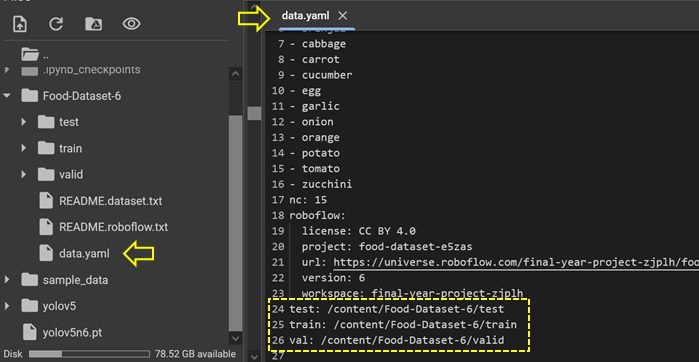

### Before training the model, You must update paths of the data.yamal file located in Food-Dataset-6 to reflect the current derectory structure.

>--> Locate the **Food-Dataset-6** folder

>--> open **data.yaml**

>Update **paths** 👇
```
test : /content/Food-Dataset-6/test
train : /content/Food-Dataset-6/train
val : /content/Food-Dataset-6/valid
```
>--> Hit ' **Ctrl + s** ' to save




#  <font color='cyan'>**YOLO**<font color='white'>**v5**<font color='lightblue'>**n6**</font></font></font> 💠  <font color='white'>Detection Model</font>

 Download pretraind model from ultralytics

In [ ]:
#%cd /content/
%cd /content/drive/MyDrive/Veg_dtect
model_1 = torch.hub.load('ultralytics/yolov5', 'yolov5n6')  # light model

/content/drive/MyDrive/Veg_dtect


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-4-27 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5n6 summary: 280 layers, 3239884 parameters, 0 gradients, 4.6 GFLOPs
Adding AutoShape... 


### **Model-1** <font color='yellow'>**Architecture**</font>

In [ ]:
print(model_1)

AutoShape(
  (model): DetectMultiBackend(
    (model): DetectionModel(
      (model): Sequential(
        (0): Conv(
          (conv): Conv2d(3, 16, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2))
          (act): SiLU(inplace=True)
        )
        (1): Conv(
          (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (act): SiLU(inplace=True)
        )
        (2): C3(
          (cv1): Conv(
            (conv): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv2): Conv(
            (conv): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv3): Conv(
            (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (m): Sequential(
            (0): Bottleneck(
              (cv1): Conv(
                (conv): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1))
  


### **Model-1** <font color='lime'>**Summary**</font>

In [ ]:
import torch
model=model_1
def summarize_model(model):
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    non_trainable_params = total_params - trainable_params

    layer_count = sum(1 for _ in model.modules())
    conv_layer_count = sum(1 for m in model.modules() if isinstance(m, torch.nn.Conv2d))
    pool_layer_count = sum(1 for m in model.modules() if isinstance(m, torch.nn.MaxPool2d) or isinstance(m, torch.nn.AvgPool2d))
    padding_count = sum(m.padding[0] if isinstance(m.padding, tuple) else m.padding
                        for m in model.modules() if isinstance(m, torch.nn.Conv2d))
    dense_layer_count = sum(1 for m in model.modules() if isinstance(m, torch.nn.Linear))

    print(f"Total params         : {total_params:,}")
   # print(f"Trainable params     : {trainable_params:,}")
   # print(f"Non-trainable params : {non_trainable_params:,}")
    print(f"Total layers         : {layer_count}")
    print(f"Convolutional layers : {conv_layer_count}")
    print(f"Pooling layers       : {pool_layer_count}")
    print(f"Total padding used   : {padding_count}")
    print(f"Dense layers         : {dense_layer_count}")

# Summarize the model
summarize_model(model)


Total params         : 3,239,884
Total layers         : 282
Convolutional layers : 79
Pooling layers       : 1
Total padding used   : 24
Dense layers         : 0


### 🔀 Inferance before training


image 1/1: 600x800 1 banana, 2 apples, 1 orange, 1 dining table
Speed: 202.8ms pre-process, 187.3ms inference, 34.0ms NMS per image at shape (1, 3, 512, 640)


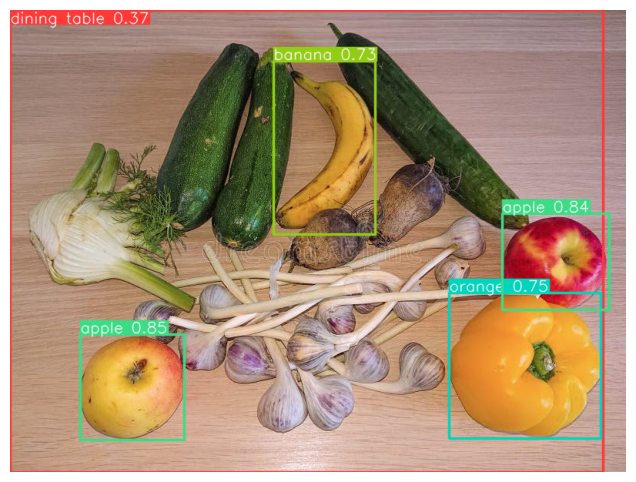

In [ ]:
#🥕 Image source
img = "https://thumbs.dreamstime.com/b/vegetables-fruits-arranged-table-apple-garlic-banana-pepper-beetroot-fennel-courgette-cucumber-different-organic-wooden-163962585.jpg"

# Run inferance on model
results = model(img)
results.print()
%matplotlib inline
plt.figure(figsize=(10, 6))
plt.imshow(np.squeeze(results.render()))
plt.axis("off")
plt.show()

## 🚀 <font color='cyan'>**YOLO**<font color='white'>**v5**<font color='lightblue'>**n6**</font></font></font> **Model Training 1**

### Train for 50 epochs, SGD optimizer, lr0 = 0.01, lrf = 0.01

In [ ]:
EPOCHS = 50   # Number of epochs to train for
# To change hyperparameters goto 👉 hyp= drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml

%cd /content/
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py \
  --data /content/Food-Dataset-6/data.yaml \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5n6.pt \
  --img 640 \
  --epochs {EPOCHS} \
  --batch-size 16 \
  --cache \
  --workers 2

2024-04-21 05:19:13.889150: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-21 05:19:13.889216: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-21 05:19:13.890719: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=/content/drive/MyDrive/Veg_dtect/yolov5n6.pt, cfg=, data=/content/Food-Dataset-6/data.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=drive/MyDrive/Veg_dtect/yolov5/data

<font size="+1"> 👇 Resume training from where it got inturupted. ( Not required if no interrupts )


In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py --resume /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/last.pt

2024-04-21 10:18:29.913675: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-21 10:18:29.913728: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-21 10:18:29.915254: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=drive/MyDrive/Veg_dtect/yolov5/yolov5s.pt, cfg=, data=drive/MyDrive/Veg_dtect/yolov5/data/coco128.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/last.pt, nosave=False, noval=False, noautoanchor=False, nop

<font size="5"> Evaluate trained model ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/val.py \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/best.pt \
  --data /content/Food-Dataset-6/data.yaml \
  --img 640 \
  --name exp

val: data=/content/Food-Dataset-6/data.yaml, weights=['/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=drive/MyDrive/Veg_dtect/yolov5/runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
val: Scanning /content/Food-Dataset-6/valid/labels.cache... 1392 images, 0 backgrounds, 0 corrupt: 100% 1392/1392 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
             

<font size="+1">All training curves, metrics, and other results are stored as images in the 'runs' directory. Lets open a couple of these images.</font>


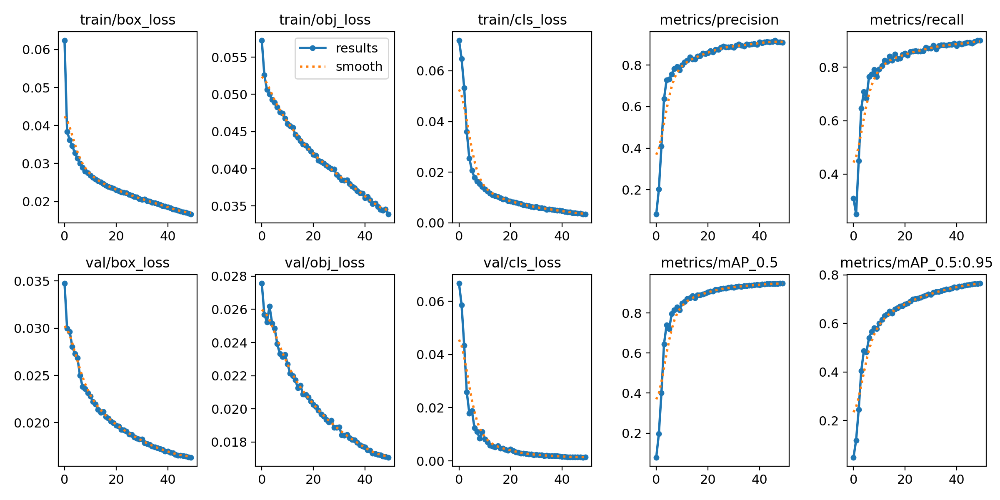

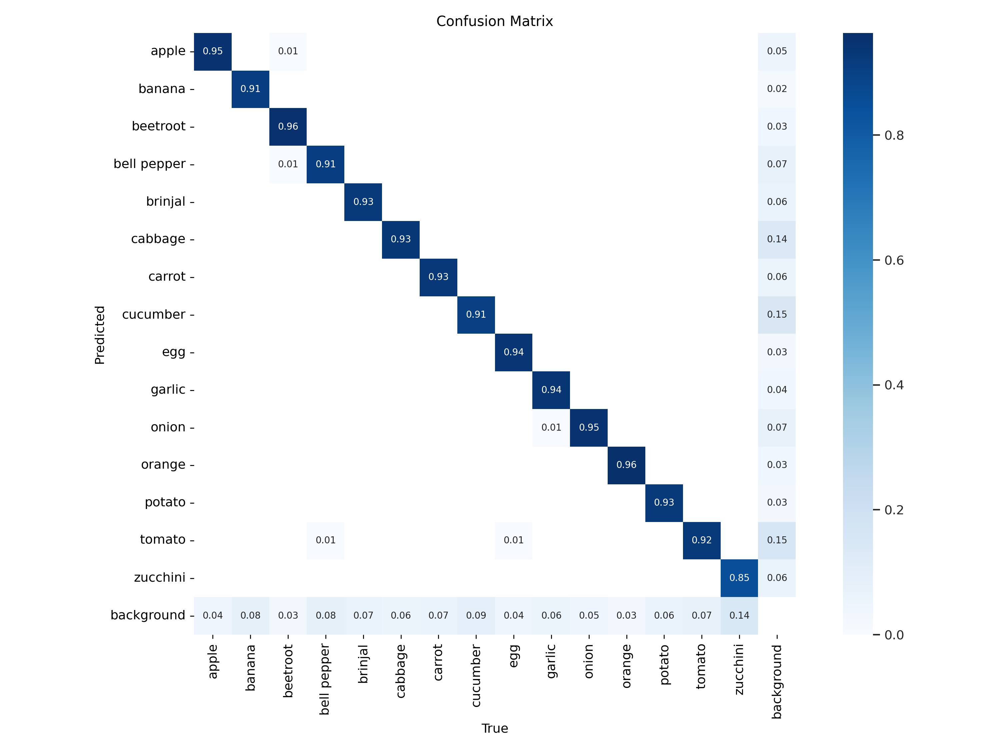

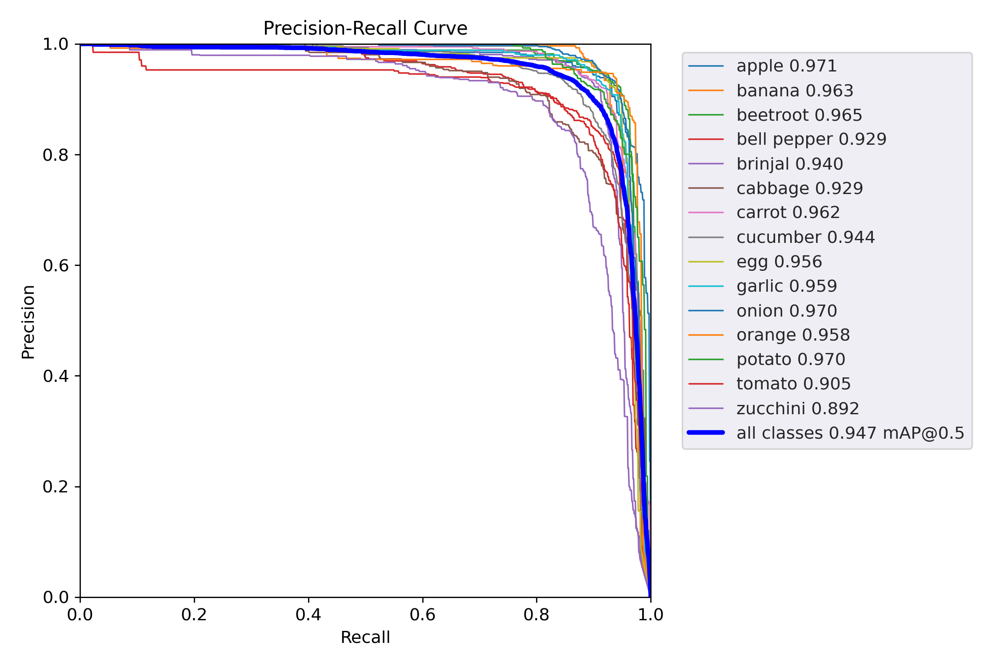

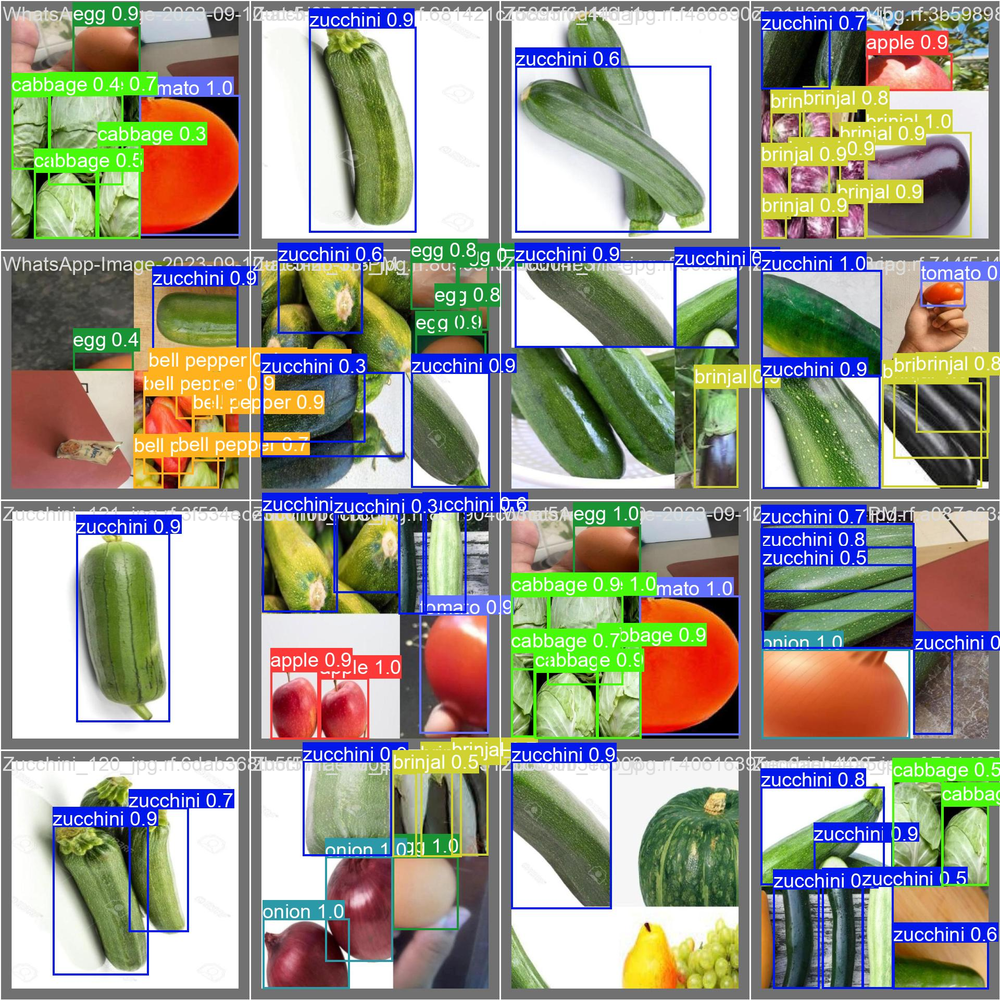

In [ ]:
from IPython.display import display, Image
# Define the paths to the images
image_paths = [
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/results.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/confusion_matrix.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/PR_curve.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/val_batch2_pred.jpg'
]
# Display each image
for image_path in image_paths:
    display(Image(filename=image_path, width=650))

<font size="5">Model **Prediction** ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [ ]:
%cd /content/
import torch
vgmod_1 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/best.pt', force_reload=True)


/content


/usr/local/lib/python3.10/dist-packages/torch/hub.py:294: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-4-26 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
Adding AutoShape... 


<font size="+1"> **Predict :**</font>

image 1/1: 400x570 2 apples, 2 bell peppers, 7 garlics, 1 onion
Speed: 3.4ms pre-process, 14.6ms inference, 2.4ms NMS per image at shape (1, 3, 512, 640)


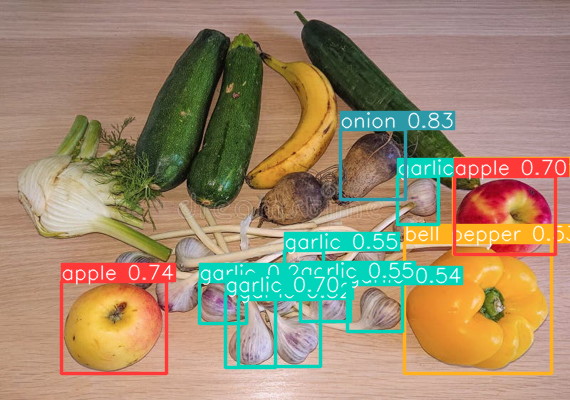

image 1/1: 400x570 2 apples, 1 banana
Speed: 3.0ms pre-process, 14.2ms inference, 1.7ms NMS per image at shape (1, 3, 512, 640)


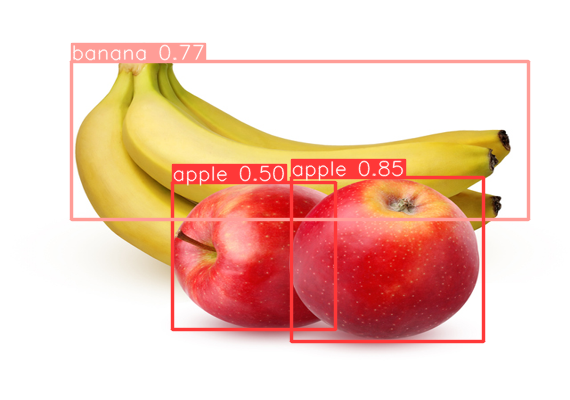

image 1/1: 400x570 1 cabbage, 5 carrots, 1 garlic, 1 onion, 2 potatos
Speed: 2.9ms pre-process, 10.9ms inference, 1.7ms NMS per image at shape (1, 3, 512, 640)


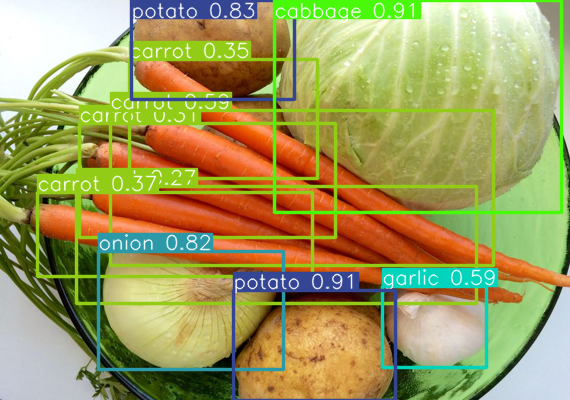

image 1/1: 400x570 1 beetroot, 1 carrot
Speed: 5.0ms pre-process, 10.9ms inference, 1.6ms NMS per image at shape (1, 3, 512, 640)


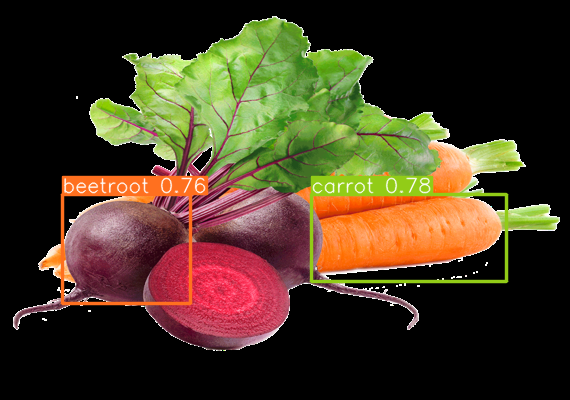

image 1/1: 400x570 1 bell pepper, 1 carrot, 2 cucumbers, 11 tomatos
Speed: 2.9ms pre-process, 10.7ms inference, 1.7ms NMS per image at shape (1, 3, 512, 640)


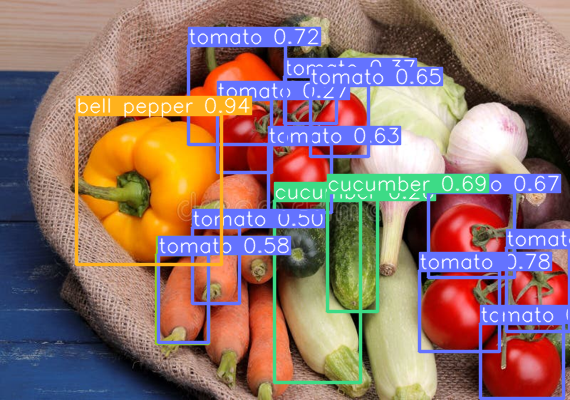

image 1/1: 400x570 1 carrot, 2 cucumbers, 3 tomatos
Speed: 2.9ms pre-process, 10.7ms inference, 1.5ms NMS per image at shape (1, 3, 512, 640)


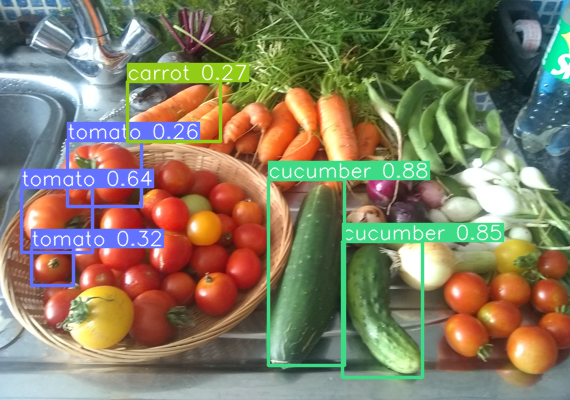

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import requests
from io import BytesIO

# Function to resize an image
def resize_image(image, size):
    return image.resize(size)

# Function to perform inference on a resized image
def perform_inference(image):
    # Perform inference
    results = vgmod_1(image)
    return results

# List of image URLs
image_urls = [
    'https://thumbs.dreamstime.com/b/vegetables-fruits-arranged-table-apple-garlic-banana-pepper-beetroot-fennel-courgette-cucumber-different-organic-wooden-163962585.jpg',
    'https://www.freshpoint.com/wp-content/uploads/2019/08/freshpoint-produce-101-apples-bananas.jpg',
    'https://www.thespruceeats.com/thmb/7dXfvFpiRZVTSqCSPbDyP_HSFFU=/960x0/filters:no_upscale():max_bytes(150000):strip_icc()/cabbagepotatocarrot-5c112d8546e0fb0001204291.jpg',
    'https://odofarms.com/wp-content/uploads/2018/11/slider_beets_carrots-1024x932.png',
    'https://thumbs.dreamstime.com/b/vegetables-including-garlic-cucumbers-cabbage-onion-pepper-beetroot-carrot-zucchini-tomatoes-bag-blue-wooden-table-125026718.jpg',
    'https://i.pinimg.com/originals/3f/61/19/3f6119c602801f51ec4924cb11c71c2a.jpg',
    # Add the paths to the remaining images here
]

# Perform inference on each image and display results
for image_url in image_urls:
    # Load image from URL
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content))

    # Resize image to desired dimensions
    resized_image = resize_image(image, (570, 400))  # Resize to desired dimensions

    # Perform inference on resized image
    results = perform_inference(resized_image)

    # Display results
    plt.figure(figsize=(10, 10))
    plt.imshow(resized_image)
    results.print()
    results.show()
    plt.axis("off")
    plt.show()


<font size="+1">Prediction connfidance is low

###🚀🚀 **Retrain** ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp**</font>/weights/<font color='cyan'>**best.pt**</font> ]</font>

### Continue Training <font color="white">**best.pt**</font> model from last checkpoint


### Train for <font color="white"> 10 epochs, optimizer : SGD (default), lr0 : 0.01</font></font>

In [ ]:
EPOCHS = 10
%cd /content/
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py \
  --data /content/Food-Dataset-6/data.yaml \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/best.pt \
  --img 640 --epochs {EPOCHS} --batch-size 16 --cache --workers 2

2024-04-21 12:28:22.318130: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-21 12:28:22.318237: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-21 12:28:22.320075: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp/weights/best.pt, cfg=, data=/content/Food-Dataset-6/data.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=drive/MyD


<font size="+2"> Evaluate Retrained model<font color="white"> ▶ [ yolov5/runs/train/<font color="#7FFF00">**exp2**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font> with <font color="white">val.py</font>


In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/val.py \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/weights/best.pt \
  --data /content/Food-Dataset-6/data.yaml \
  --img 640 \
  --name exp2

val: data=/content/Food-Dataset-6/data.yaml, weights=['/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=drive/MyDrive/Veg_dtect/yolov5/runs/val, name=exp2, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
val: Scanning /content/Food-Dataset-6/valid/labels.cache... 1392 images, 0 backgrounds, 0 corrupt: 100% 1392/1392 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
           

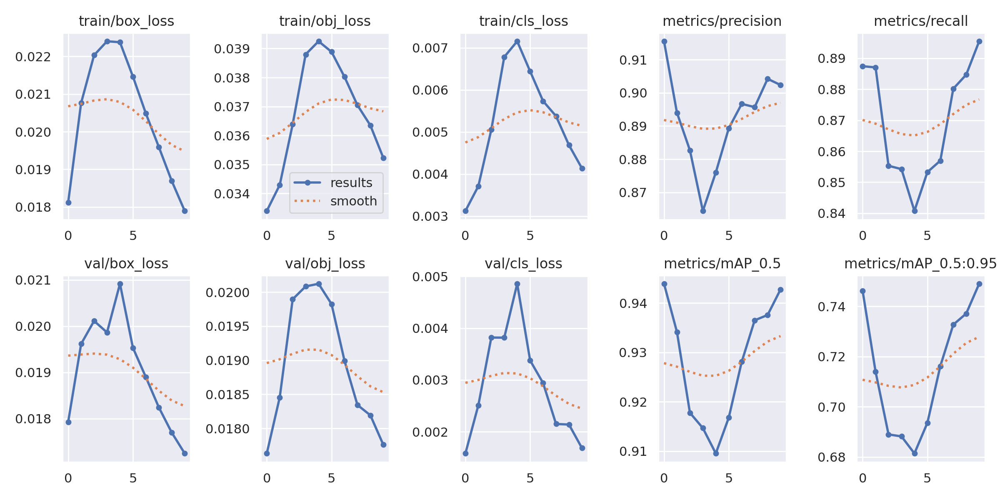

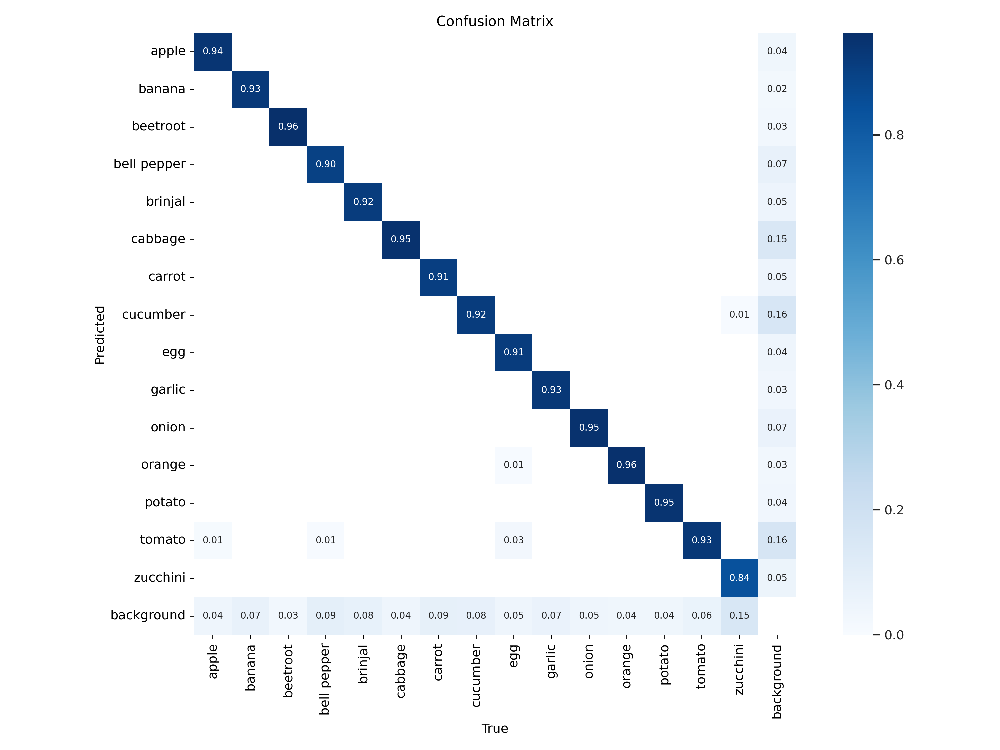

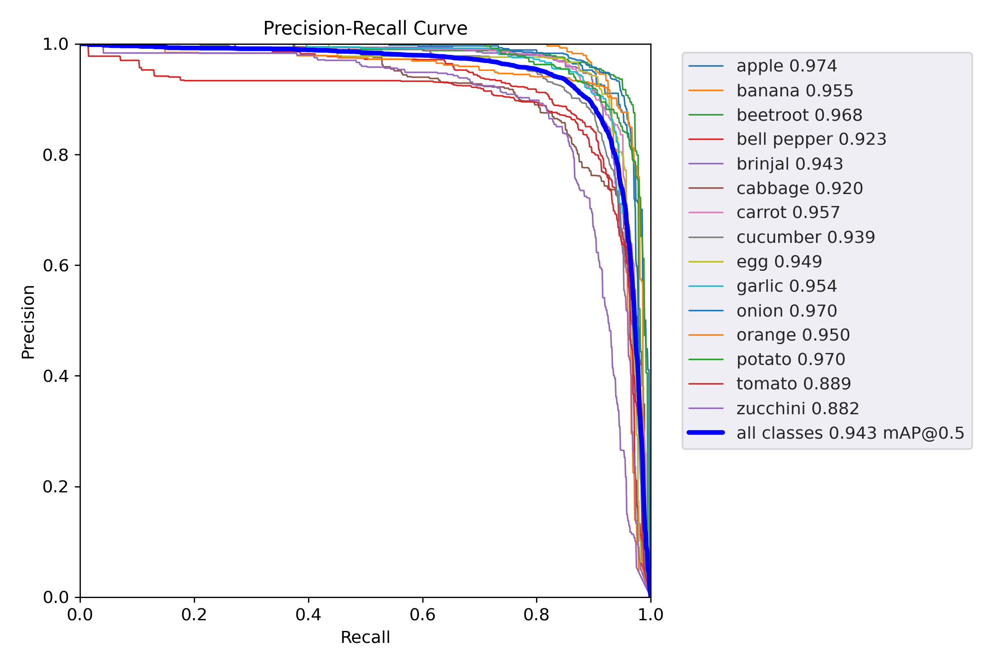

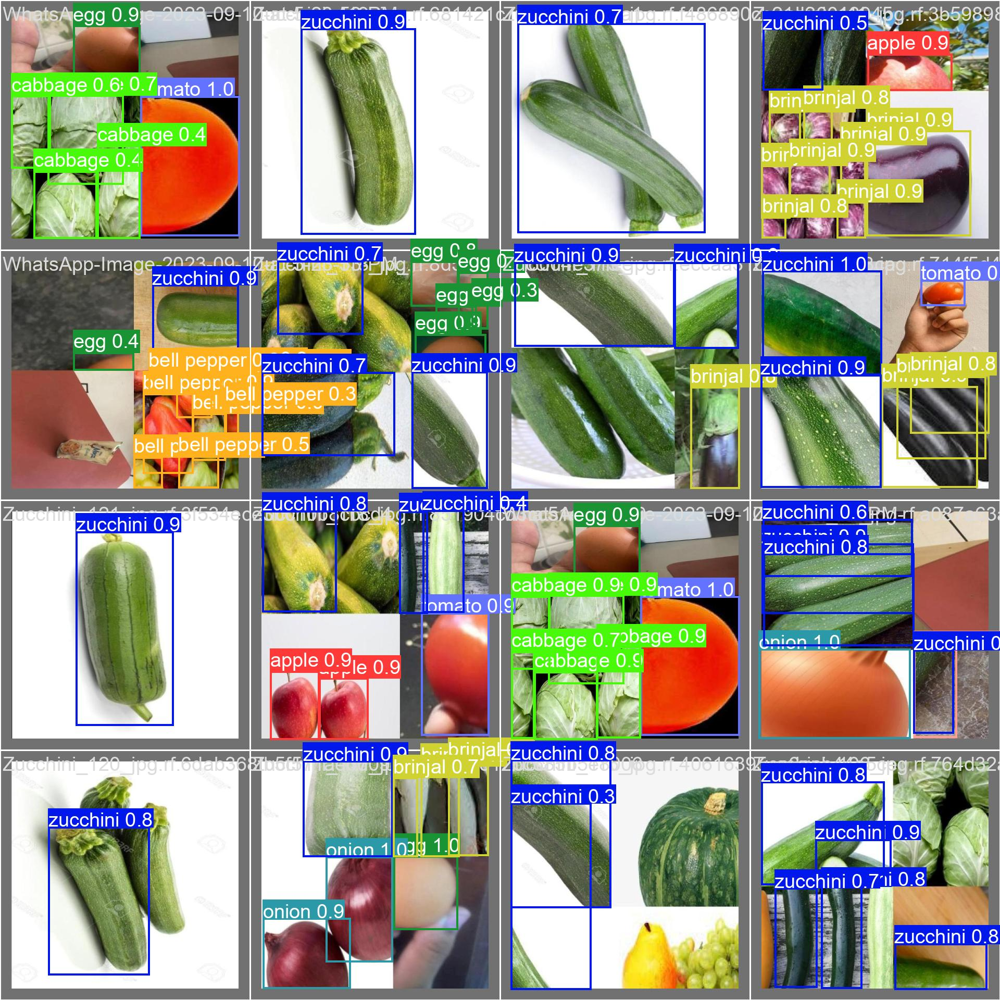

In [ ]:
from IPython.display import display, Image
# Define the paths to the images
image_paths = [
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/results.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/confusion_matrix.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/PR_curve.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/val_batch2_pred.jpg'
]
# Display each image
for image_path in image_paths:
    display(Image(filename=image_path, width=650))


<font size="+2"> Rerained model **Prediction** ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp2**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [ ]:
%cd /content/
import torch
vgmod_2 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp2/weights/best.pt', force_reload=True)

/content


Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-4-26 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
Adding AutoShape... 


image 1/1: 400x570 2 apples, 1 banana, 2 bell peppers, 3 cucumbers, 5 garlics, 1 onion
Speed: 4.0ms pre-process, 13.3ms inference, 2.1ms NMS per image at shape (1, 3, 512, 640)


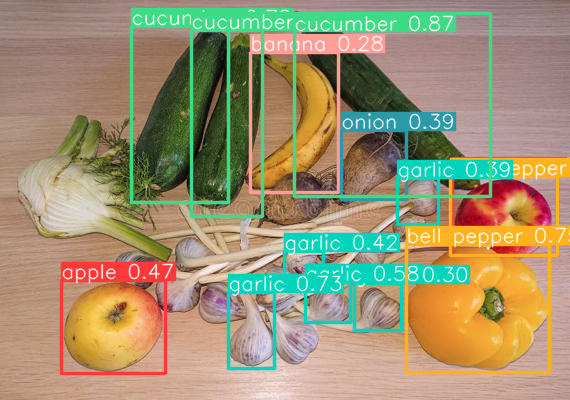

image 1/1: 400x570 1 apple, 1 banana
Speed: 3.9ms pre-process, 16.1ms inference, 2.0ms NMS per image at shape (1, 3, 512, 640)


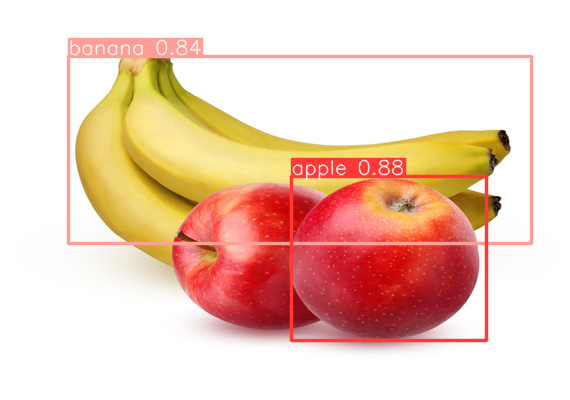

image 1/1: 400x570 1 cabbage, 4 carrots, 1 garlic, 1 onion, 2 potatos
Speed: 3.6ms pre-process, 22.5ms inference, 2.0ms NMS per image at shape (1, 3, 512, 640)


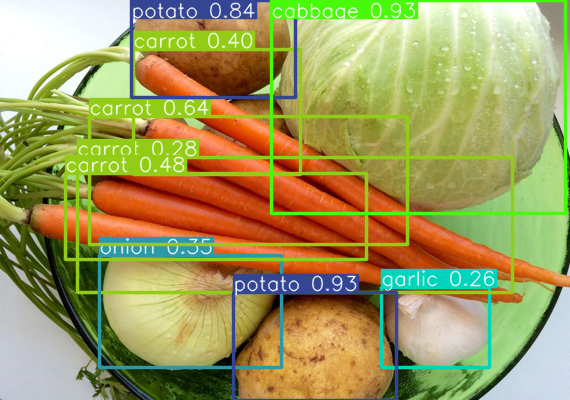

image 1/1: 400x570 2 beetroots, 1 carrot, 1 onion
Speed: 8.0ms pre-process, 16.0ms inference, 2.3ms NMS per image at shape (1, 3, 512, 640)


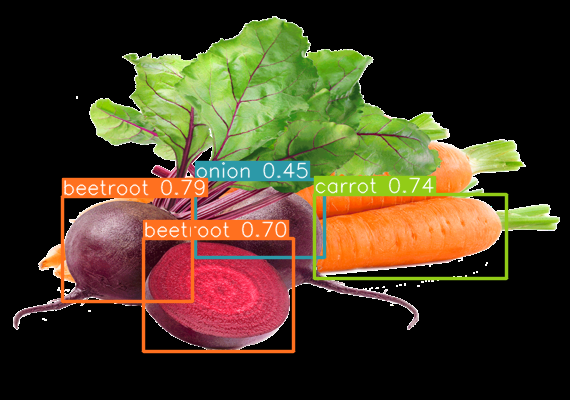

image 1/1: 400x570 3 bell peppers, 3 carrots, 1 cucumber, 9 tomatos
Speed: 4.1ms pre-process, 22.8ms inference, 2.5ms NMS per image at shape (1, 3, 512, 640)


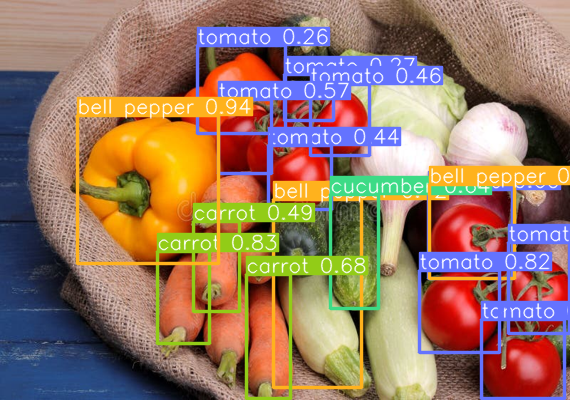

image 1/1: 400x570 1 beetroot, 6 carrots, 2 cucumbers, 4 tomatos
Speed: 2.9ms pre-process, 10.5ms inference, 1.7ms NMS per image at shape (1, 3, 512, 640)


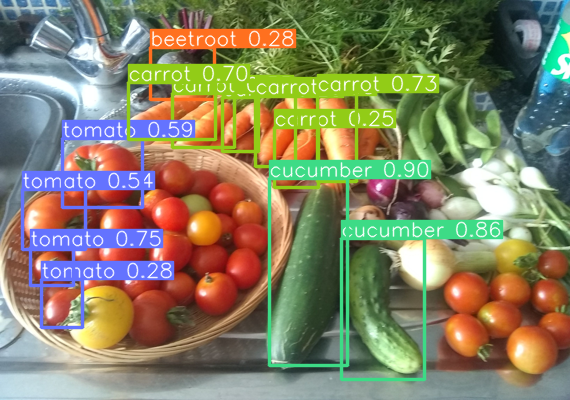

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import requests
from io import BytesIO

# Function to resize an image
def resize_image(image, size):
    return image.resize(size)

# Function to perform inference on a resized image
def perform_inference(image):
    # Perform inference
    results = vgmod_2(image)
    return results

# List of image URLs
image_urls = [
    'https://thumbs.dreamstime.com/b/vegetables-fruits-arranged-table-apple-garlic-banana-pepper-beetroot-fennel-courgette-cucumber-different-organic-wooden-163962585.jpg',
    'https://www.freshpoint.com/wp-content/uploads/2019/08/freshpoint-produce-101-apples-bananas.jpg',
    'https://www.thespruceeats.com/thmb/7dXfvFpiRZVTSqCSPbDyP_HSFFU=/960x0/filters:no_upscale():max_bytes(150000):strip_icc()/cabbagepotatocarrot-5c112d8546e0fb0001204291.jpg',
    'https://odofarms.com/wp-content/uploads/2018/11/slider_beets_carrots-1024x932.png',
    'https://thumbs.dreamstime.com/b/vegetables-including-garlic-cucumbers-cabbage-onion-pepper-beetroot-carrot-zucchini-tomatoes-bag-blue-wooden-table-125026718.jpg',
    'https://i.pinimg.com/originals/3f/61/19/3f6119c602801f51ec4924cb11c71c2a.jpg',
    # Add the paths to the remaining images here
]

# Perform inference on each image and display results
for image_url in image_urls:
    # Load image from URL
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content))

    # Resize image to desired dimensions
    resized_image = resize_image(image, (570, 400))  # Resize to desired dimensions

    # Perform inference on resized image
    results = perform_inference(resized_image)

    # Display results
    plt.figure(figsize=(10, 10))
    plt.imshow(resized_image)
    results.print()
    results.show()
    plt.axis("off")
    plt.show()



<font size="+1">Prediction reults exhibits somewhat improved detection compared to the previous model but it still performed poorly in some images. </font>

## 🚀 <font color='cyan'>**YOLO**<font color='white'>**v5**<font color='lightblue'>**n6**</font></font></font> **Model Training 2**

### Train for <font color="white"> 25 epochs, Adam, lr0 = 0.001, lrf = 0.001

In [ ]:
EPOCHS = 25
# lr0 = 0.001, lrf = 0.001
# To change hyperparameters goto 👉 hyp= drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml

%cd /content/
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py \
  --data /content/Food-Dataset-6/data.yaml \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5n6.pt \
  --img 640 \
  --epochs {EPOCHS} \
  --batch-size 16 \
  --cache \
  --patience 5 \
  --seed 42 \
  --optimizer Adam \
  --name exp8 \
  --workers 5

/content
2024-04-26 16:46:48.752931: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-26 16:46:48.752984: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-26 16:46:48.754484: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=/content/drive/MyDrive/Veg_dtect/yolov5n6.pt, cfg=, data=/content/Food-Dataset-6/data.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=drive/MyDrive/Veg_dtect/yo

<font size="5"> Evaluate trained model ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp8**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [3]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/val.py \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/weights/best.pt \
  --data /content/Food-Dataset-6/data.yaml \
  --img 640 \
  --name exp8

val: data=/content/Food-Dataset-6/data.yaml, weights=['/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=drive/MyDrive/Veg_dtect/yolov5/runs/val, name=exp8, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
100% 755k/755k [00:00<00:00, 28.7MB/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/Food-Dataset-6/valid/labels... 1392 images, 0 backgrounds, 0 corrupt: 100% 1392/

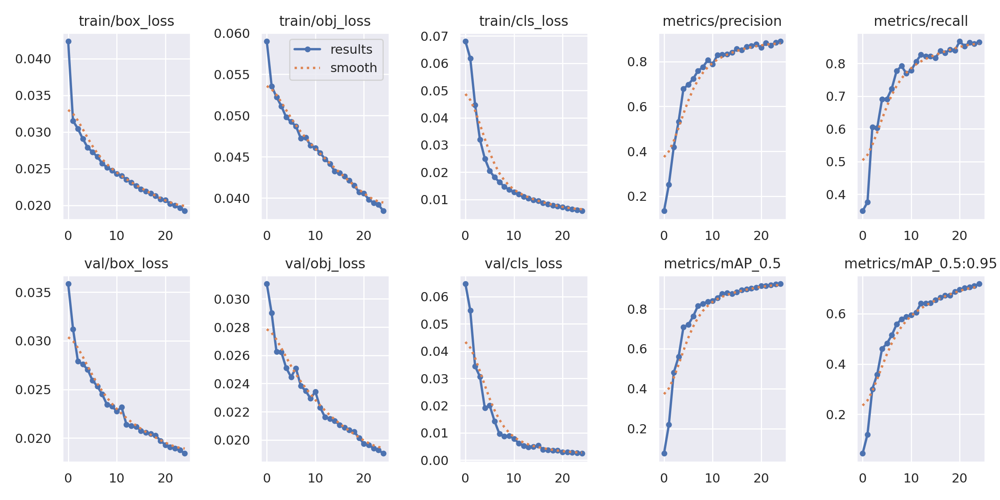

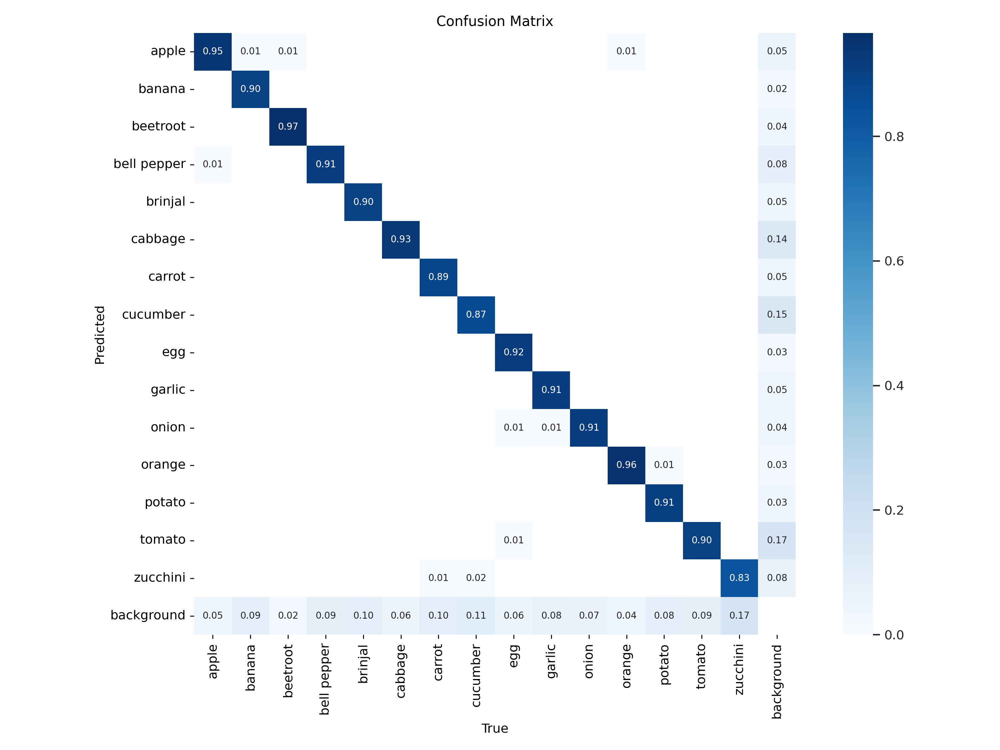

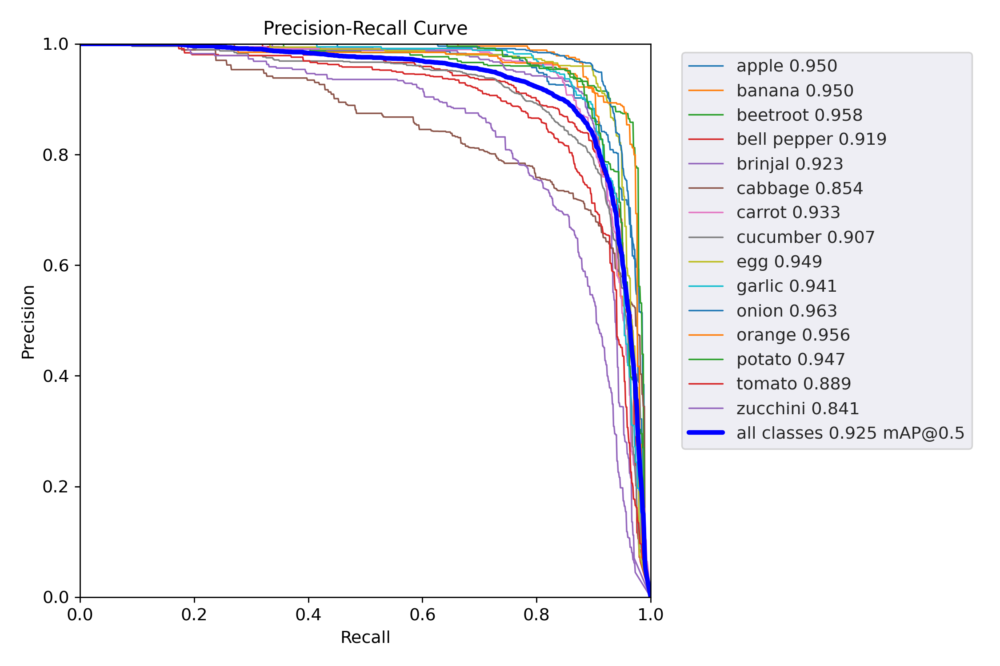

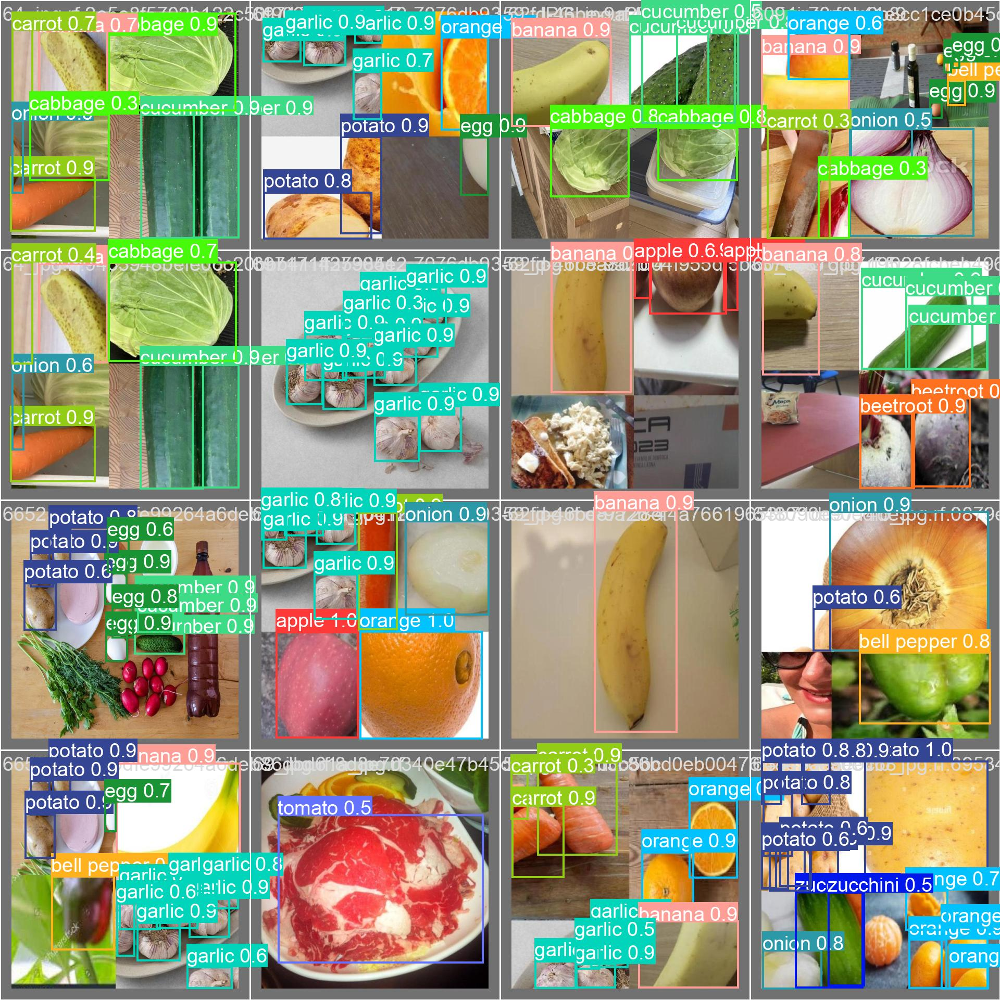

In [7]:
from IPython.display import display, Image
# Define the paths to the images
image_paths = [
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/results.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/confusion_matrix.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/PR_curve.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/val_batch2_pred.jpg'
]
# Display each image
for image_path in image_paths:
    display(Image(filename=image_path, width=650))

<font size="5">Model **Prediction** ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp8**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [2]:
%cd /content/
import torch
vgmod_8 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/weights/best.pt', force_reload=True)

/content


/usr/local/lib/python3.10/dist-packages/torch/hub.py:294: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-4-27 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
Adding AutoShape... 


WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1: 400x570 2 apples, 1 banana, 1 bell pepper, 3 cucumbers, 3 garlics, 2 onions, 1 potato
Speed: 27.3ms pre-process, 337.0ms inference, 1826.4ms NMS per image at shape (1, 3, 512, 640)


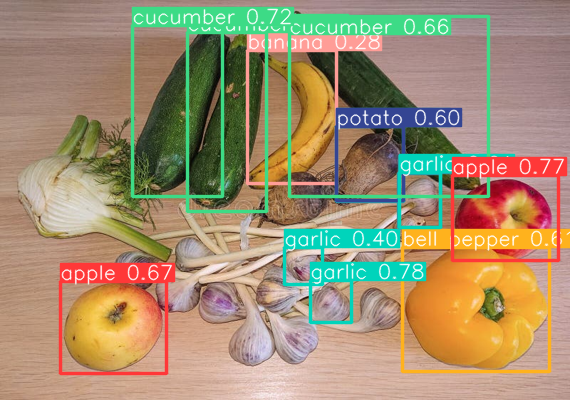

image 1/1: 400x570 2 apples, 1 banana
Speed: 10.1ms pre-process, 21.9ms inference, 2.3ms NMS per image at shape (1, 3, 512, 640)


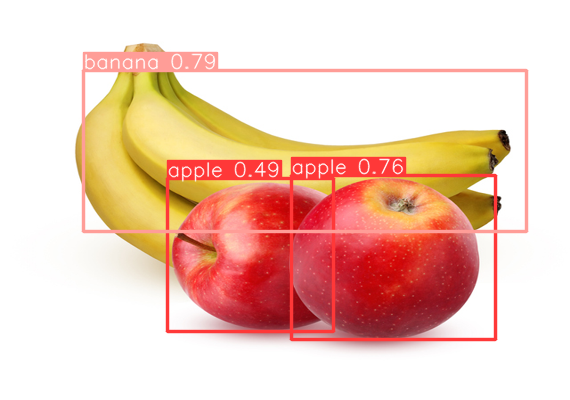

image 1/1: 400x570 1 cabbage, 4 carrots, 2 potatos
Speed: 6.8ms pre-process, 20.9ms inference, 2.0ms NMS per image at shape (1, 3, 512, 640)


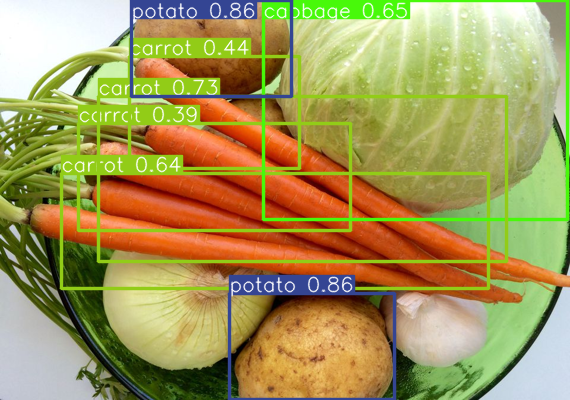

image 1/1: 400x570 3 beetroots, 1 cabbage, 1 carrot
Speed: 6.5ms pre-process, 15.2ms inference, 2.2ms NMS per image at shape (1, 3, 512, 640)


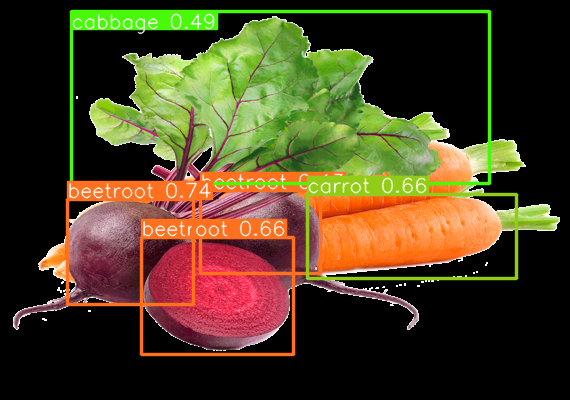

image 1/1: 400x570 1 bell pepper, 7 carrots, 1 cucumber, 2 onions, 1 potato, 8 tomatos
Speed: 11.0ms pre-process, 15.1ms inference, 2.1ms NMS per image at shape (1, 3, 512, 640)


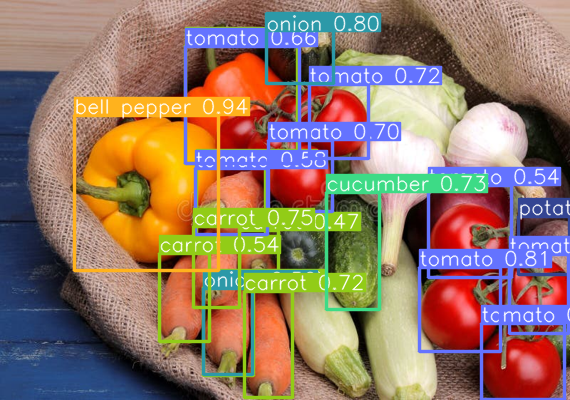

image 1/1: 400x570 5 carrots, 2 cucumbers, 4 onions, 14 tomatos
Speed: 3.6ms pre-process, 26.8ms inference, 9.2ms NMS per image at shape (1, 3, 512, 640)


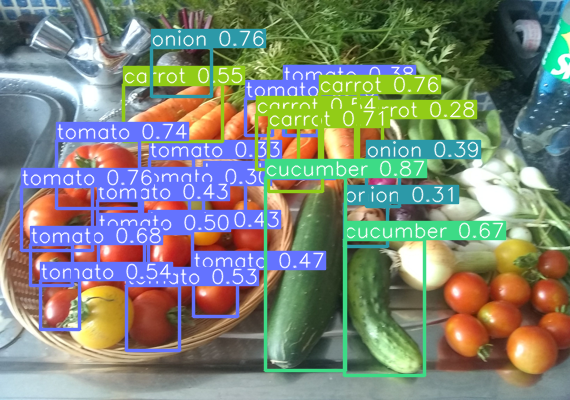

In [3]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import requests
from io import BytesIO

# Function to resize an image
def resize_image(image, size):
    return image.resize(size)

# Function to perform inference on a resized image
def perform_inference(image):
    # Perform inference
    results = vgmod_8(image)
    return results

# List of image URLs
image_urls = [
    'https://thumbs.dreamstime.com/b/vegetables-fruits-arranged-table-apple-garlic-banana-pepper-beetroot-fennel-courgette-cucumber-different-organic-wooden-163962585.jpg',
    'https://www.freshpoint.com/wp-content/uploads/2019/08/freshpoint-produce-101-apples-bananas.jpg',
    'https://www.thespruceeats.com/thmb/7dXfvFpiRZVTSqCSPbDyP_HSFFU=/960x0/filters:no_upscale():max_bytes(150000):strip_icc()/cabbagepotatocarrot-5c112d8546e0fb0001204291.jpg',
    'https://odofarms.com/wp-content/uploads/2018/11/slider_beets_carrots-1024x932.png',
    'https://thumbs.dreamstime.com/b/vegetables-including-garlic-cucumbers-cabbage-onion-pepper-beetroot-carrot-zucchini-tomatoes-bag-blue-wooden-table-125026718.jpg',
    'https://i.pinimg.com/originals/3f/61/19/3f6119c602801f51ec4924cb11c71c2a.jpg',
    # Add the paths to the remaining images here
]

# Perform inference on each image and display results
for image_url in image_urls:
    # Load image from URL
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content))

    # Resize image to desired dimensions
    resized_image = resize_image(image, (570, 400))  # Resize to desired dimensions

    # Perform inference on resized image
    results = perform_inference(resized_image)

    # Display results
    plt.figure(figsize=(10, 10))
    plt.imshow(resized_image)
    results.print()
    results.show()
    plt.axis("off")
    plt.show()


## 🚀 <font color='cyan'>**YOLO**<font color='white'>**v5**<font color='lightblue'>**n6**</font></font></font> **Model Training 3**

### Train for 40 epochs, AdamW, lr0 = 0.0001, lrf = 0.0001

In [ ]:
EPOCHS = 40   # Number of epochs to train for
# lr0 = 0.0001, lrf = 0.0001
# To change hyperparameters 👉 Goto hyp= drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml

%cd /content/
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py \
  --data /content/Food-Dataset-6/data.yaml \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5n6.pt \
  --img 640 \
  --epochs {EPOCHS} \
  --batch-size 16 \
  --cache \
  --patience 5 \
  --seed 42 \
  --optimizer AdamW \
  --name exp10 \
  --workers 5

/content
2024-04-26 20:21:23.337686: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-26 20:21:23.337737: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-26 20:21:23.339112: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=/content/drive/MyDrive/Veg_dtect/yolov5n6.pt, cfg=, data=/content/Food-Dataset-6/data.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=drive/MyDrive/Veg_dtect/yo

In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py --resume /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10//weights/last.pt

2024-04-26 22:03:36.527158: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-26 22:03:36.527212: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-26 22:03:36.529123: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=drive/MyDrive/Veg_dtect/yolov5/yolov5s.pt, cfg=, data=drive/MyDrive/Veg_dtect/yolov5/data/coco128.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10//weights/last.pt, nosave=False, noval=False, noautoanchor=False, 

Training completed

<font size="5"> Evaluate trained model ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp10**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/val.py \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/weights/best.pt \
  --data /content/Food-Dataset-6/data.yaml \
  --img 640 \
  --name exp10

val: data=/content/Food-Dataset-6/data.yaml, weights=['/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=drive/MyDrive/Veg_dtect/yolov5/runs/val, name=exp10, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
val: Scanning /content/Food-Dataset-6/valid/labels.cache... 1392 images, 0 backgrounds, 0 corrupt: 100% 1392/1392 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
         

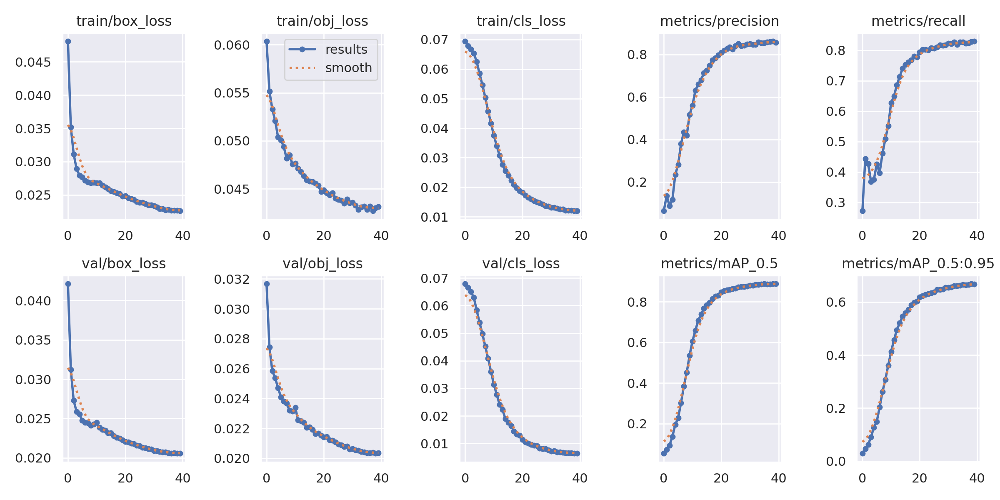

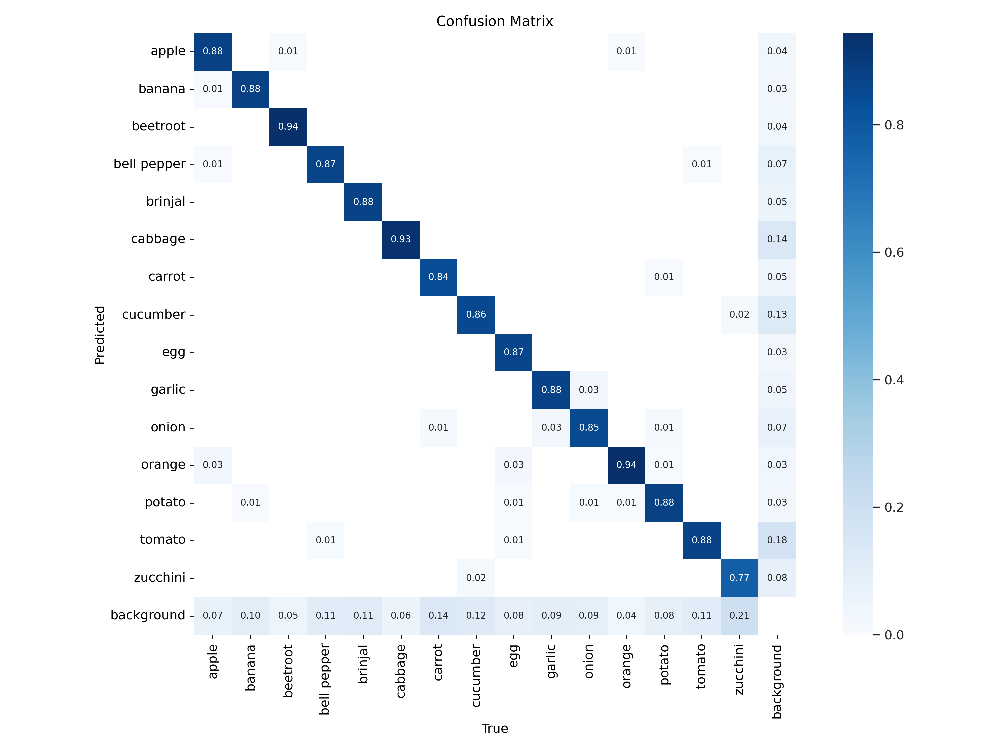

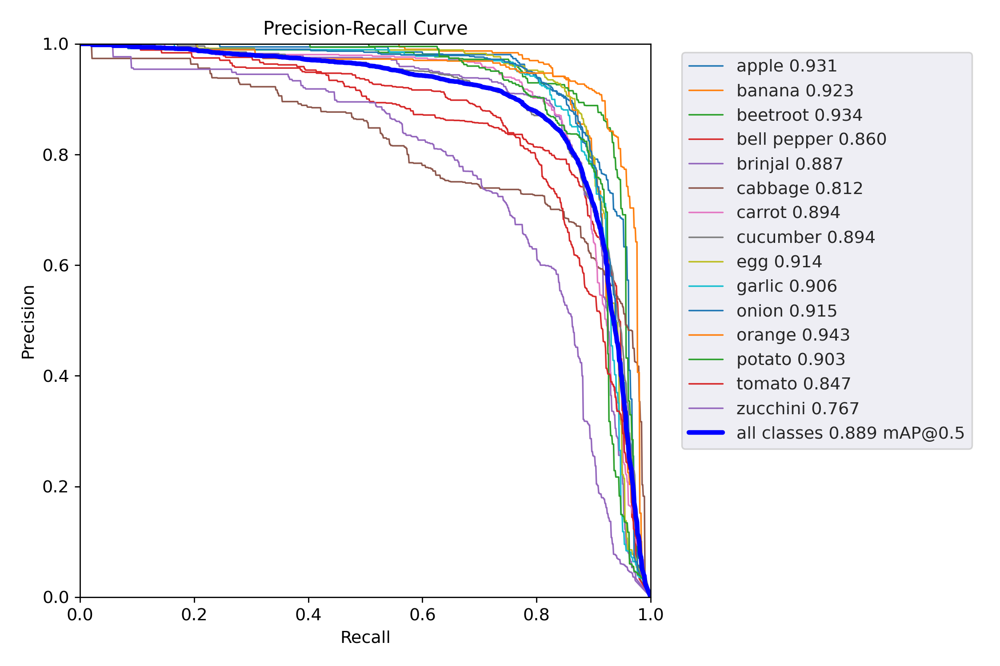

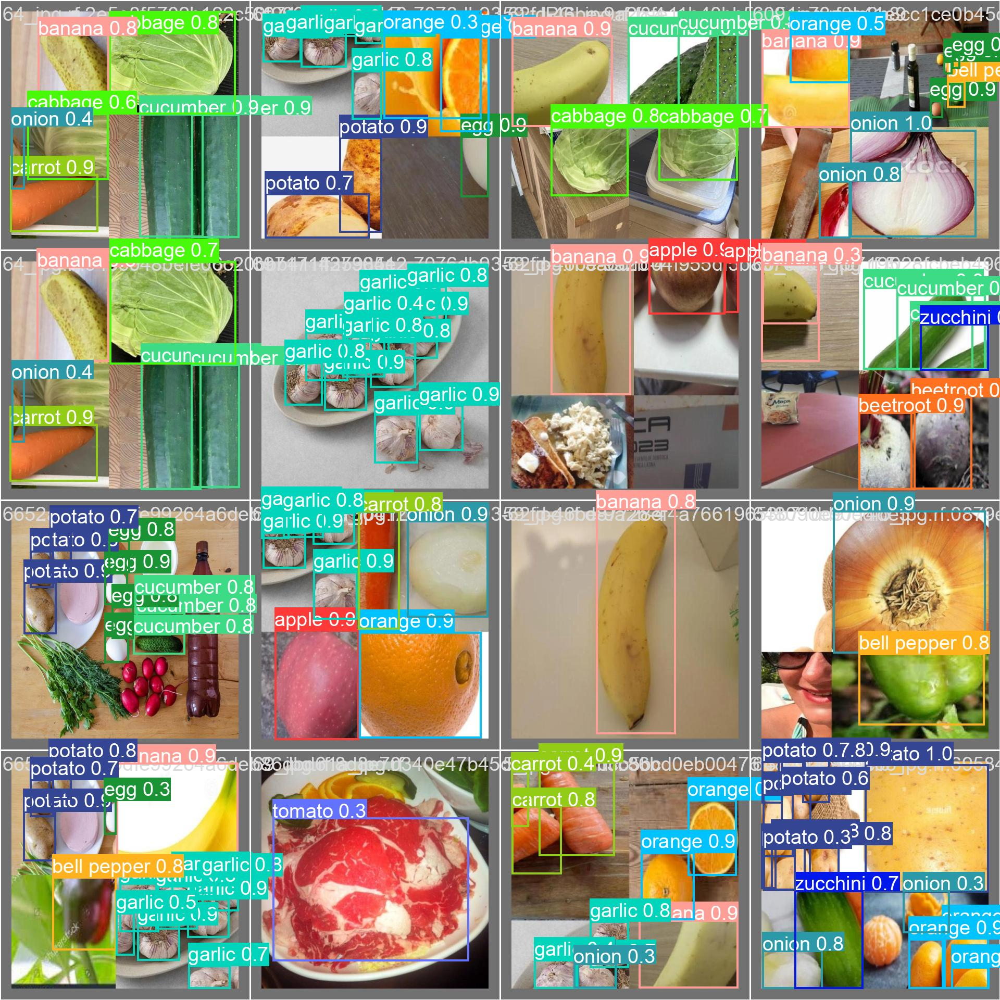

In [ ]:
from IPython.display import display, Image
# Define the paths to the images
image_paths = [
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/results.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/confusion_matrix.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/PR_curve.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/val_batch2_pred.jpg'
]
# Display each image
for image_path in image_paths:
    display(Image(filename=image_path, width=650))

<font size="5">Model **Prediction** ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp10**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [4]:
%cd /content/
import torch
vgmod_10 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/weights/best.pt', force_reload=True)


/content


Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-4-27 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
Adding AutoShape... 


image 1/1: 400x570 2 apples, 1 banana, 1 carrot, 2 cucumbers, 2 garlics, 2 onions, 1 potato, 1 tomato, 1 zucchini
Speed: 3.3ms pre-process, 10.6ms inference, 1.5ms NMS per image at shape (1, 3, 512, 640)


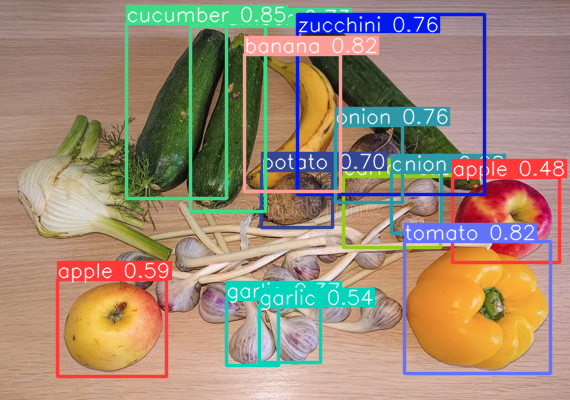

image 1/1: 400x570 1 apple, 1 banana
Speed: 2.8ms pre-process, 8.9ms inference, 1.6ms NMS per image at shape (1, 3, 512, 640)


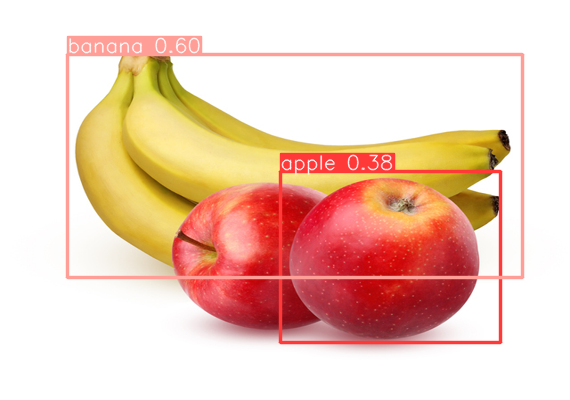

image 1/1: 400x570 1 cabbage, 4 carrots, 1 garlic, 1 onion, 2 potatos
Speed: 3.8ms pre-process, 8.8ms inference, 1.4ms NMS per image at shape (1, 3, 512, 640)


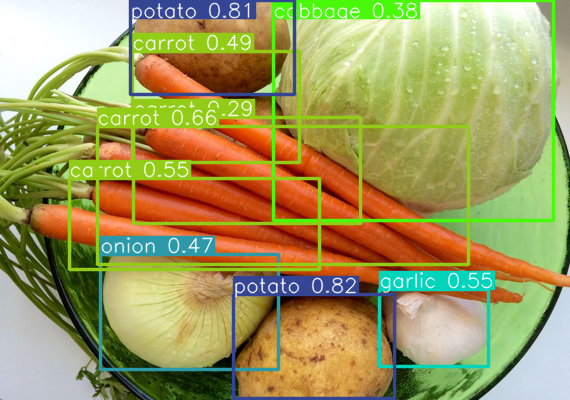

image 1/1: 400x570 3 beetroots, 1 cabbage, 1 carrot
Speed: 4.0ms pre-process, 8.4ms inference, 3.2ms NMS per image at shape (1, 3, 512, 640)


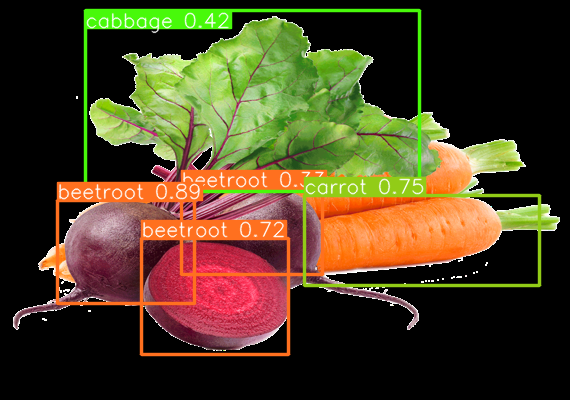

image 1/1: 400x570 1 bell pepper, 1 cabbage, 4 carrots, 1 cucumber, 3 onions, 8 tomatos
Speed: 2.5ms pre-process, 10.4ms inference, 1.5ms NMS per image at shape (1, 3, 512, 640)


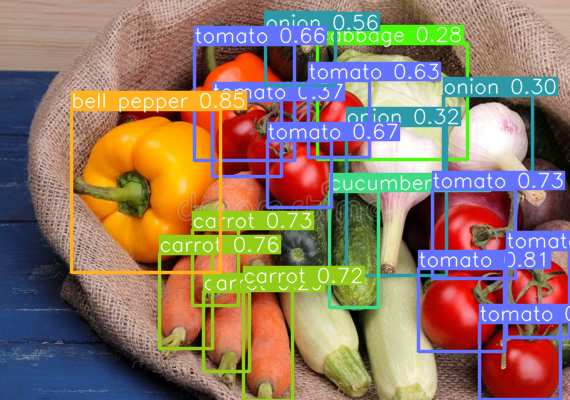

image 1/1: 400x570 6 carrots, 2 cucumbers, 1 egg, 2 onions, 1 orange, 19 tomatos
Speed: 2.5ms pre-process, 8.3ms inference, 1.5ms NMS per image at shape (1, 3, 512, 640)


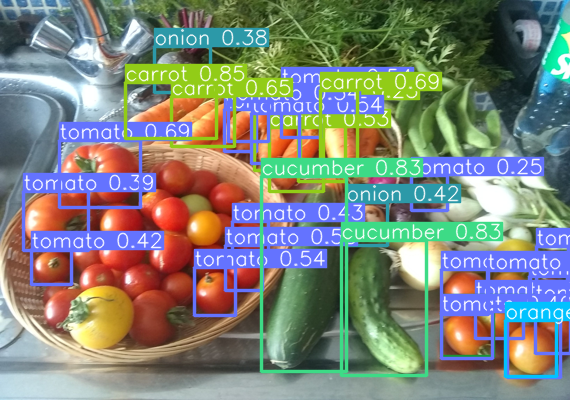

In [5]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import requests
from io import BytesIO

# Function to resize an image
def resize_image(image, size):
    return image.resize(size)

# Function to perform inference on a resized image
def perform_inference(image):
    # Perform inference
    results = vgmod_10(image)
    return results

# List of image URLs
image_urls = [
    'https://thumbs.dreamstime.com/b/vegetables-fruits-arranged-table-apple-garlic-banana-pepper-beetroot-fennel-courgette-cucumber-different-organic-wooden-163962585.jpg',
    'https://www.freshpoint.com/wp-content/uploads/2019/08/freshpoint-produce-101-apples-bananas.jpg',
    'https://www.thespruceeats.com/thmb/7dXfvFpiRZVTSqCSPbDyP_HSFFU=/960x0/filters:no_upscale():max_bytes(150000):strip_icc()/cabbagepotatocarrot-5c112d8546e0fb0001204291.jpg',
    'https://odofarms.com/wp-content/uploads/2018/11/slider_beets_carrots-1024x932.png',
    'https://thumbs.dreamstime.com/b/vegetables-including-garlic-cucumbers-cabbage-onion-pepper-beetroot-carrot-zucchini-tomatoes-bag-blue-wooden-table-125026718.jpg',
    'https://i.pinimg.com/originals/3f/61/19/3f6119c602801f51ec4924cb11c71c2a.jpg',
    # Add the paths to the remaining images here
]

# Perform inference on each image and display results
for image_url in image_urls:
    # Load image from URL
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content))

    # Resize image to desired dimensions
    resized_image = resize_image(image, (570, 400))  # Resize to desired dimensions

    # Perform inference on resized image
    results = perform_inference(resized_image)

    # Display results
    plt.figure(figsize=(10, 10))
    plt.imshow(resized_image)
    results.print()
    results.show()
    plt.axis("off")
    plt.show()


## 🚀 <font color='cyan'>**YOLO**<font color='white'>**v5**<font color='lightblue'>**n6**</font></font></font> **Model Training 4**

### Train for 40 epochs, Adam, lr0 = 0.0005, lrf = 0.0005

In [ ]:
EPOCHS = 40   # Number of epochs to train for
# lr0 = 0.0005, lrf = 0.0005
# To change hyperparameters goto 👉 hyp= drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml

%cd /content/
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py \
  --data /content/Food-Dataset-6/data.yaml \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5n6.pt \
  --img 640 \
  --epochs {EPOCHS} \
  --batch-size 16 \
  --cache \
  --patience 5 \
  --seed 42 \
  --optimizer Adam \
  --name exp11 \
  --workers 5

/content
2024-04-26 21:33:35.051650: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-26 21:33:35.051721: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-26 21:33:35.053658: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=/content/drive/MyDrive/Veg_dtect/yolov5n6.pt, cfg=, data=/content/Food-Dataset-6/data.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=drive/MyDrive/Veg_dtect/yo

In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/train.py --resume /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/weights/last.pt

2024-04-26 21:54:23.068814: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-26 21:54:23.068866: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-26 21:54:23.070276: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=drive/MyDrive/Veg_dtect/yolov5/yolov5s.pt, cfg=, data=drive/MyDrive/Veg_dtect/yolov5/data/coco128.yaml, hyp=drive/MyDrive/Veg_dtect/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/weights/last.pt, nosave=False, noval=False, noautoanchor=False, n

Training completed

<font size="5"> Evaluate trained model ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp11**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [ ]:
!python /content/drive/MyDrive/Veg_dtect/yolov5/val.py \
  --weights /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/weights/best.pt \
  --data /content/Food-Dataset-6/data.yaml \
  --img 640 \
  --name exp11

val: data=/content/Food-Dataset-6/data.yaml, weights=['/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=drive/MyDrive/Veg_dtect/yolov5/runs/val, name=exp11, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
val: Scanning /content/Food-Dataset-6/valid/labels.cache... 1392 images, 0 backgrounds, 0 corrupt: 100% 1392/1392 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
         

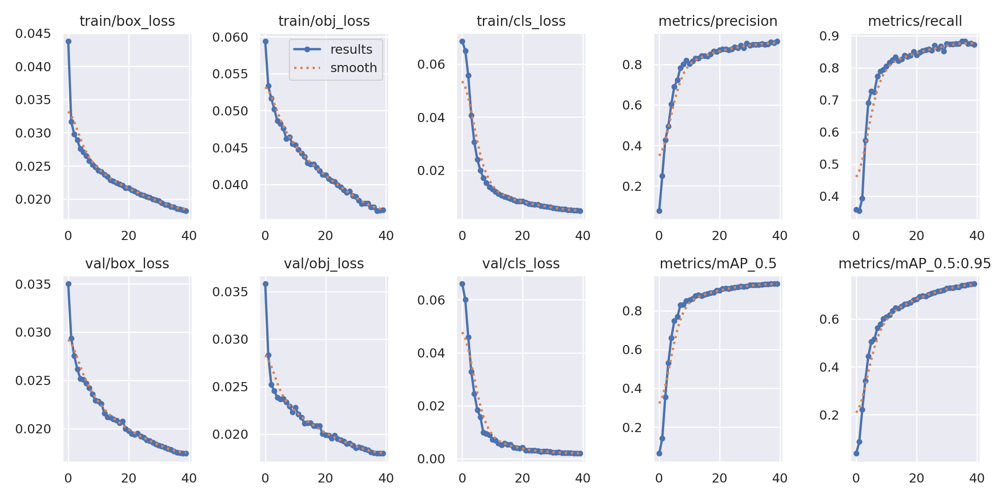

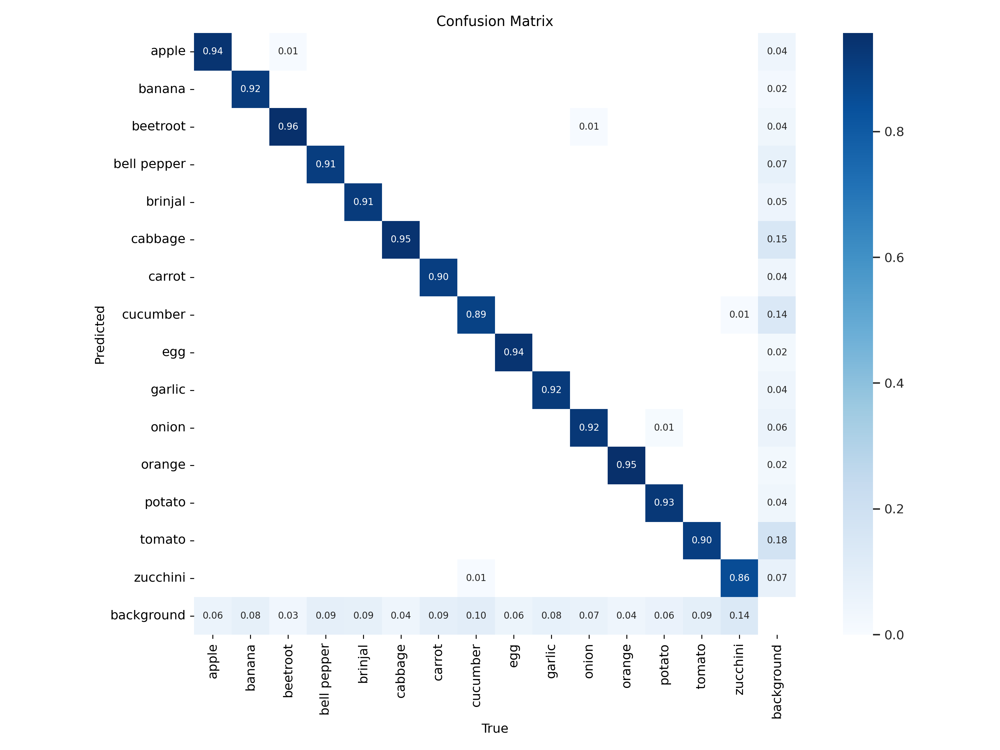

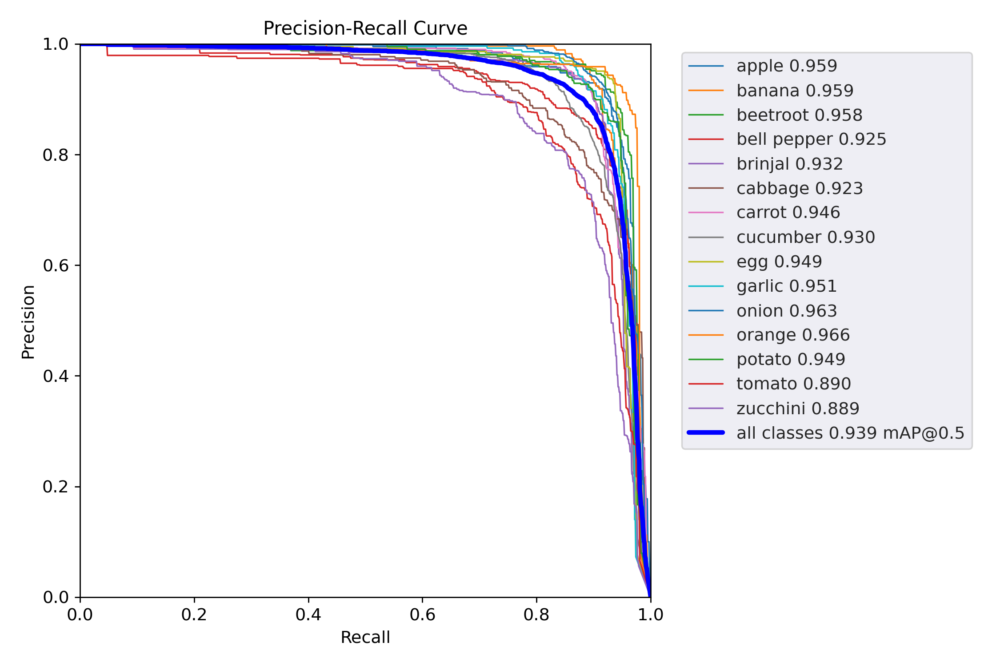

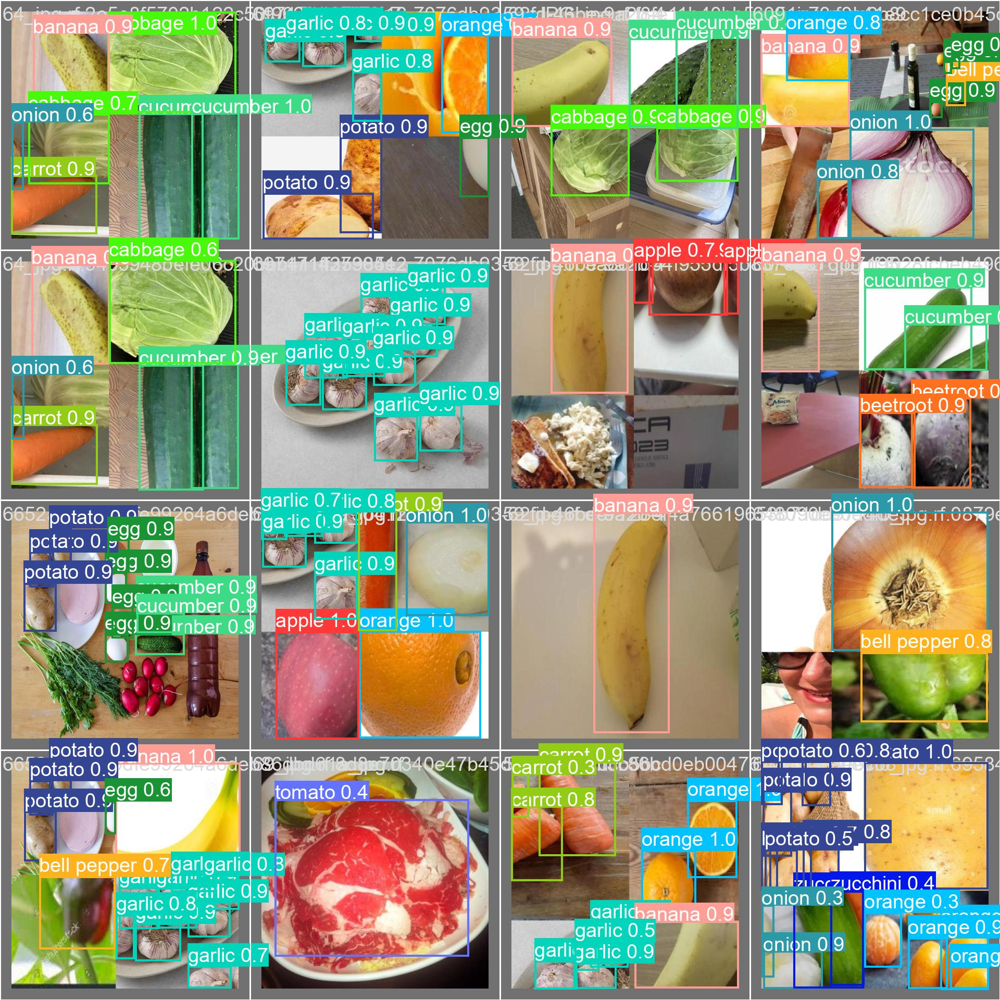

In [ ]:
from IPython.display import display, Image
# Define the paths to the images
image_paths = [
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/results.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/confusion_matrix.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/PR_curve.png',
    '/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/val_batch2_pred.jpg'
]
# Display each image
for image_path in image_paths:
    display(Image(filename=image_path, width=650))

<font size="5">Model **Prediction** ▶ <font color="white">[ yolov5/runs/train/<font color="#7FFF00">**exp11**</font>/weights/<font color='cyan'>**best.p**t</font> ]</font>


In [ ]:
%cd /content/
import torch
vgmod_11 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp11/weights/best.pt', force_reload=True)


/content


Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-4-27 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 206 layers, 3114304 parameters, 0 gradients, 4.3 GFLOPs
Adding AutoShape... 


image 1/1: 400x570 2 bell peppers, 4 cucumbers, 4 garlics, 1 onion
Speed: 3.4ms pre-process, 15.3ms inference, 1.4ms NMS per image at shape (1, 3, 512, 640)


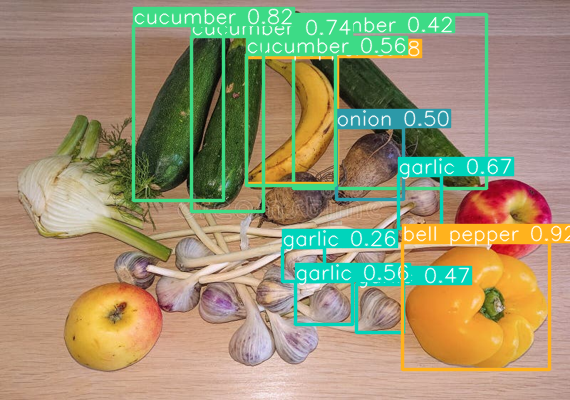

image 1/1: 400x570 1 apple, 1 banana
Speed: 2.6ms pre-process, 8.4ms inference, 1.5ms NMS per image at shape (1, 3, 512, 640)


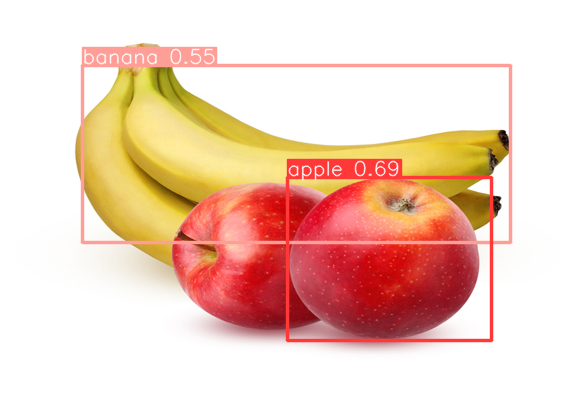

image 1/1: 400x570 1 cabbage, 2 carrots, 1 garlic, 2 potatos
Speed: 2.6ms pre-process, 8.6ms inference, 1.4ms NMS per image at shape (1, 3, 512, 640)


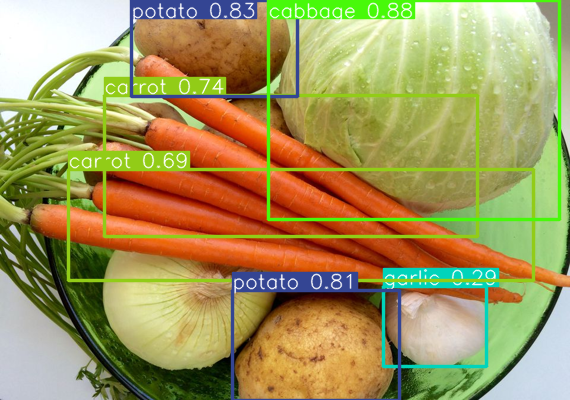

image 1/1: 400x570 2 beetroots, 1 cabbage, 1 carrot
Speed: 4.2ms pre-process, 8.9ms inference, 1.4ms NMS per image at shape (1, 3, 512, 640)


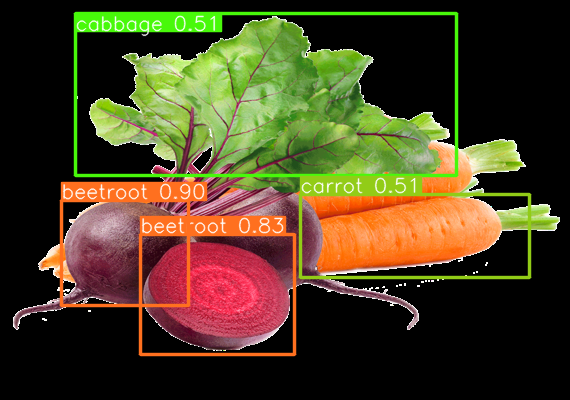

image 1/1: 400x570 1 bell pepper, 4 carrots, 1 cucumber, 2 garlics, 1 onion, 9 tomatos
Speed: 4.3ms pre-process, 9.1ms inference, 1.5ms NMS per image at shape (1, 3, 512, 640)


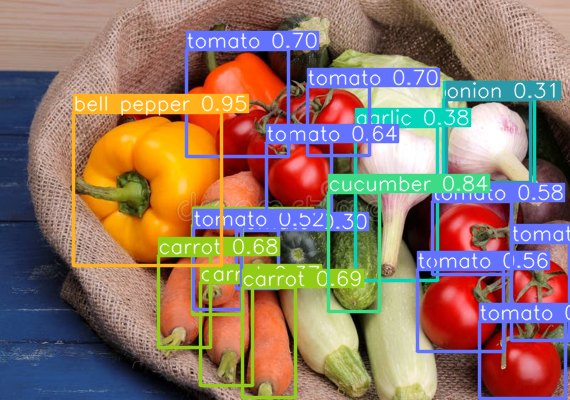

image 1/1: 400x570 5 carrots, 2 cucumbers, 1 onion, 9 tomatos
Speed: 3.0ms pre-process, 9.7ms inference, 1.6ms NMS per image at shape (1, 3, 512, 640)


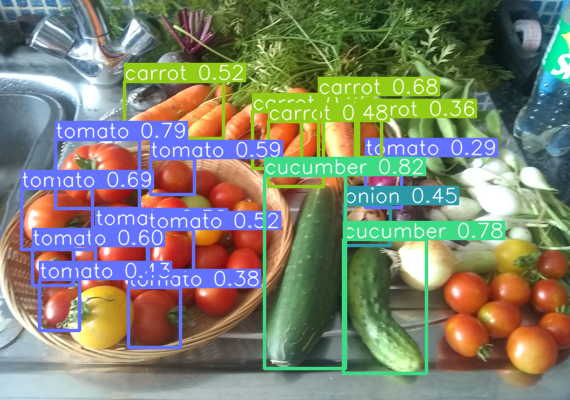

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import requests
from io import BytesIO

# Function to resize an image
def resize_image(image, size):
    return image.resize(size)

# Function to perform inference on a resized image
def perform_inference(image):
    # Perform inference
    results = vgmod_11(image)
    return results

# List of image URLs
image_urls = [
    'https://thumbs.dreamstime.com/b/vegetables-fruits-arranged-table-apple-garlic-banana-pepper-beetroot-fennel-courgette-cucumber-different-organic-wooden-163962585.jpg',
    'https://www.freshpoint.com/wp-content/uploads/2019/08/freshpoint-produce-101-apples-bananas.jpg',
    'https://www.thespruceeats.com/thmb/7dXfvFpiRZVTSqCSPbDyP_HSFFU=/960x0/filters:no_upscale():max_bytes(150000):strip_icc()/cabbagepotatocarrot-5c112d8546e0fb0001204291.jpg',
    'https://odofarms.com/wp-content/uploads/2018/11/slider_beets_carrots-1024x932.png',
    'https://thumbs.dreamstime.com/b/vegetables-including-garlic-cucumbers-cabbage-onion-pepper-beetroot-carrot-zucchini-tomatoes-bag-blue-wooden-table-125026718.jpg',
    'https://i.pinimg.com/originals/3f/61/19/3f6119c602801f51ec4924cb11c71c2a.jpg',
    # Add the paths to the remaining images here
]

# Perform inference on each image and display results
for image_url in image_urls:
    # Load image from URL
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content))

    # Resize image to desired dimensions
    resized_image = resize_image(image, (570, 400))  # Resize to desired dimensions

    # Perform inference on resized image
    results = perform_inference(resized_image)

    # Display results
    plt.figure(figsize=(10, 10))
    plt.imshow(resized_image)
    results.print()
    results.show()
    plt.axis("off")
    plt.show()


#🌟 **Conclution :**


*    After thorough comparison of all metrics; training loss, validation loss, and mAP
 across all models, it is evident that all the models are performing satisfactorily.

*    However, upon inspecting the predicted images, two models stood out for their exceptional detection accuracy and minimal false positives.
<br/>

### ⚡ Model Training 2
    Train parameters :  25 epochs, Adam, lr0 = 0.001, lrf = 0.001

**[ Best.pt ]** path 👉 /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp8/weights/best.pt


### ⚡ Model Training 3
    Train parameters : 40 epochs, AdamW, lr0 = 0.0001, lrf = 0.0001

**[ Best.pt ]** path 👉 /content/drive/MyDrive/Veg_dtect/yolov5/runs/train/exp10/weights/best.pt

